In [1]:
from IPython.display import Markdown, display
def printmd(string):
    display(Markdown(string))

# Assignment #3 - Neural Networks

 

 ### Alekhya Majeti
### 801135655

# I. Overview

The main task of this assignment is to get more detailed idea about neuralnet class and how neural networks work. This assignemnt uses both of the datasets that we were this semester for regression and classification. First part of this assignment is to do the k fold cross validation to get the best neural network parameters and get the final report for the cross validation. The next part is to implement the nonlinear logistic regression model by finishing the modules for nonlinear regression class. This model is used for my classification data.

# II. Data

for this assignment I'm using house price prediction. it consists of several features which are used to predict the price of the house. 

 - ID
 - Date
 - price
 - bedrooms
 - bathrooms
 - sqft living
 - bedrooms
 - bathrooms
 - floors
 - waterfront
 - condition 
 - grade 
 - sqft_above                
 - sqft_basement             
 - yr_built                  
 - yr_renovated             
 - zipcode                  
 - lat                     
 - long                    
 - sqft_living15            
 - sqft_lot15
 
 ## Preprocessing of data

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.offline as ply
import plotly.graph_objs as go
ply.init_notebook_mode(connected=True)

df = pd.read_csv('kc_house_data.csv')

df.head()


grades=sorted(df.grade.unique())

From the df.head we can observe that all of the values are numerical except ID. From the data visualizaiton in the last assignemnt, ID made no effect on the price. So, we can drop the ID column. Same goes with the date column as well. 

In [3]:
df = df.drop(['id', 'date'], axis=1)

print('# of data:', len(df), 'and # of features:', len(df.columns))

# of data: 21613 and # of features: 19


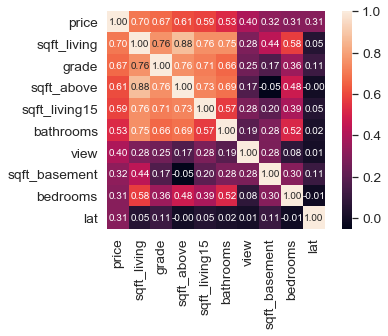

In [4]:
df_target = pd.DataFrame(df.iloc[:,0])
corrmat = df.corr()
k = 10 #number of variables for heatmap
cols = corrmat.nlargest(k, 'price')['price'].index
cm = np.corrcoef(df[cols].values.T)
sns.set(font_scale=1.25)
hm = sns.heatmap(cm, cbar=True, annot=True, square=True, fmt='.2f', annot_kws={'size': 10}, yticklabels=cols.values, xticklabels=cols.values)
plt.show()

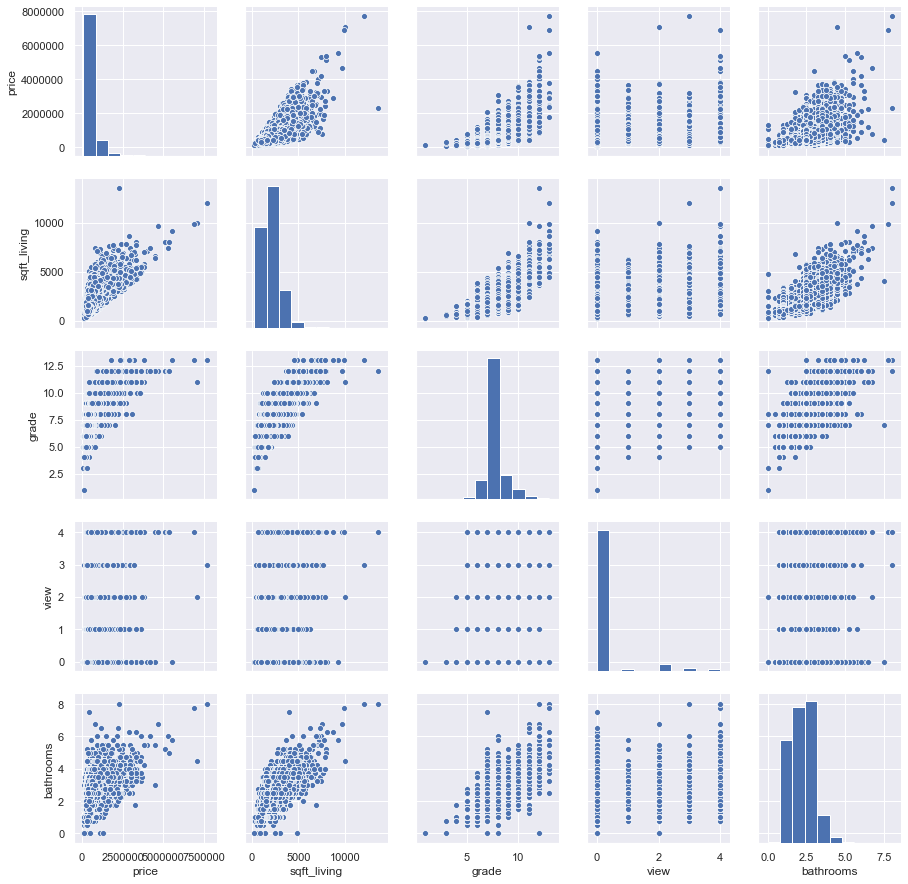

In [5]:
#scatterplot
sns.set()
cols = ['price','sqft_living', 'grade', 'view', 'bathrooms']
sns.pairplot(df[cols], height = 2.5)
plt.show();

In [6]:
trace1 = go.Scattergl(
    x=df.sqft_living,
    y=df.price,
    mode='markers',
    marker=dict(
        opacity=0.5
    ),
    #showlegend=True
)
data=[trace1]

layout = go.Layout(
    title='Price vs. Living Room Area',
    xaxis=dict(
        title='Living room area (sq. ft.)'
    ),
    yaxis=dict(
        title='Price ($)'
    ),
    hovermode='closest',
    #showlegend=True
)

figure = go.Figure(data=data, layout=layout)

ply.iplot(figure)

The graph shows the relation between living room area and price. This look like it affects the price. Lets add a line and see, it would more clearer.

In [7]:
np.any(df.isnull())



False

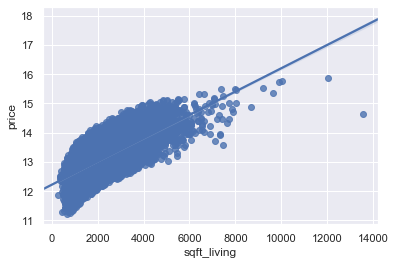

In [8]:
sns.regplot(df.sqft_living, np.log(df.price))

now we can see that is positively effecting the price. Now, we have to see if the data differ based on the number of floors, bathrooms and bedrooms of the house. 

In [9]:
dataPoints12 = go.Scattergl(
    x=df.sqft_living,
    y=np.log(df.price),
    mode='markers',
    text=[f'area of living room:{df.at[i, "sqft_living"]} sq.ft.<br>Grade:{df.at[i, "grade"]}<br>Price:${df.at[i, "price"]}' for i in range(len(df))],
    marker=dict(
        opacity=0.75,
        color=df.grade,
        showscale=True,
        colorscale='Jet',
        colorbar=dict(
            title='Grade'
        ),
    ),
    name='Data points'
)

data=[dataPoints12]

figure = go.Figure(data=data, layout=layout)

ply.iplot(figure)

The graph shows the clear relation between the living room and price with different grades. So we can see here that as grade increases the price of the house increases too with the living area. Now, lets compare this with other features as well



The graph above shows the relatioship between the living room area and the price. We can see that this feature positively effects the price of the house. Now lets see what happens if another feature is added to this.

In [10]:
grades=sorted(df.grade.unique())

In [11]:
data=[]
for g in grades:
    df_grade=df[df.grade==g]
    data.append(
        go.Scattergl(
            x=df_grade.sqft_living15,
            y=np.log(df_grade.price),
            mode='markers',
            text=[f'Living Room Area:{df_grade.at[i, "sqft_living15"]} sq.ft.<br>Grade:{df_grade.at[i, "grade"]}<br>Price:${df_grade.at[i, "price"]}' for i in df_grade.index],
            marker=dict(
                opacity=0.75,
            ),
            name='Grade:'+str(g)
        )
    )

figure = go.Figure(data=data, layout=layout)

ply.iplot(figure)    

This is a better version of the graph before with clear representation of each grade. Now lets see the impact of condition, grade and the rest of the variables together.

In [12]:
subplots=['No. of bedrooms', 'No. of bathrooms', 'Condition', 'Grade', 'Waterfront']
subplot_cols=['bedrooms', 'bathrooms', 'condition', 'grade', 'waterfront']

from plotly.subplots import make_subplots
figure=make_subplots(rows=5, cols=1, subplot_titles=['Breakup by '+col for col in subplots])

for i in range(len(subplots)):
    col_name=subplots[i]
    col=subplot_cols[i]
    col_values=sorted(df[col].unique())
    for value in col_values:
        df_subset=df[df[col]==value]
        trace=go.Scattergl(
            x=df_subset.sqft_living15,
            y=np.log(df_subset.price),
            mode='markers',
            text=[f'Living Room Area:{df_subset.at[i, "sqft_living15"]} sq.ft.<br>{col_name}:{df_subset.at[i, col]}<br>Price:${df_subset.at[i, "price"]}' for i in df_subset.index],
            marker=dict(
                opacity=0.75,
            ),
            name=col_name+':'+str(value),
            showlegend=False
        )
        figure.append_trace(trace, i+1, 1)

figure['layout'].update(
    height=2000, 
    title='Price vs. Living room area - subplots', 
    hovermode='closest',
    xaxis=dict(title='Living room area (sq. ft.)'),
    xaxis2=dict(title='Living room area (sq. ft.)'),
    xaxis3=dict(title='Living room area (sq. ft.)'),
    xaxis4=dict(title='Living room area (sq. ft.)'),
    xaxis5=dict(title='Living room area (sq. ft.)'),
    yaxis=dict(title='Log(Price)'),
    yaxis2=dict(title='Log(Price)'),
    yaxis3=dict(title='Log(Price)'),
    yaxis4=dict(title='Log(Price)'),
    yaxis5=dict(title='Log(Price)'),
)

ply.iplot(figure)

From the graphs above it is very clear that grade is the distinguishing factor for predicting price along with the living area. 

Checking for null values is always an important step and if there are any, treating them is important. Luckily, my dataset doesn't have any so I'm good to go.

In [13]:
print(df.dtypes)

price            float64
bedrooms           int64
bathrooms        float64
sqft_living        int64
sqft_lot           int64
floors           float64
waterfront         int64
view               int64
condition          int64
grade              int64
sqft_above         int64
sqft_basement      int64
yr_built           int64
yr_renovated       int64
zipcode            int64
lat              float64
long             float64
sqft_living15      int64
sqft_lot15         int64
dtype: object


Lets take a look at the data types of the dataset. From the table above we can clearly see that all of them are either int type or float type.

In [14]:
correlations = df.corr()
correlations['price']

price            1.000000
bedrooms         0.308350
bathrooms        0.525138
sqft_living      0.702035
sqft_lot         0.089661
floors           0.256794
waterfront       0.266369
view             0.397293
condition        0.036362
grade            0.667434
sqft_above       0.605567
sqft_basement    0.323816
yr_built         0.054012
yr_renovated     0.126434
zipcode         -0.053203
lat              0.307003
long             0.021626
sqft_living15    0.585379
sqft_lot15       0.082447
Name: price, dtype: float64

## Finding correlation
Correlation is a statistical measure that suggests the level of linear dependence between two variables
that occur in pair. 

Its value is between -1 to +1
Above 0 is positive correlation i.e. X is directly proportional to Y.

Below 0 is negative correlation i.e. X is inversly proportional to Y.

Value close to 0 suggests weak relation.

Picking up some of the features that are highly correlated with price
Correlation between price and sqft_living is (0.7)
Correlation between price and grade is (0.67)
Correlation between price and sqft_above is (0.61)
Correlation between price and sqft_living15 is (0.59)
Correlation between price and bathrooms is (0.53)

Now, let us evaluate the correlation of the below features with each others for multicolinearity.
We would do this later by calculating VIF
Correlation between sqft_living and sqft_above is (0.88)
Correlation between sqft_living and sqft_living15 is (0.76)
Correlation between sqft_living and grade is (0.76)
Correlation between sqft living and bathrooms is (0.75)



In [15]:
# corr = cor(df[:,1:19])
# corrplot(corr, method = "color", outline = T, cl.pos = 'n', rect.col = "black",  tl.col = "indianred4", addCoef.col = "black", number.digits = 2, number.cex = 0.60, tl.cex = 0.7, cl.cex = 1, col = colorRampPalette(c("green4","white","red")))

In [16]:
# Remove features with correlation < 0.1
cor_target = abs(correlations['price'])
removed_features = cor_target[cor_target < 0.1]
print(removed_features)

sqft_lot      0.089661
condition     0.036362
yr_built      0.054012
zipcode       0.053203
long          0.021626
sqft_lot15    0.082447
Name: price, dtype: float64


Now, it is time to find out what the features which are the least when it comes to corelation. We can get all the features which have corelation factor less than 0.01. So, from the table above the features are, sqft_lot, condition, zipcode, long, sqft_lot15. we can drop these features. 

In [17]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21613 entries, 0 to 21612
Data columns (total 19 columns):
price            21613 non-null float64
bedrooms         21613 non-null int64
bathrooms        21613 non-null float64
sqft_living      21613 non-null int64
sqft_lot         21613 non-null int64
floors           21613 non-null float64
waterfront       21613 non-null int64
view             21613 non-null int64
condition        21613 non-null int64
grade            21613 non-null int64
sqft_above       21613 non-null int64
sqft_basement    21613 non-null int64
yr_built         21613 non-null int64
yr_renovated     21613 non-null int64
zipcode          21613 non-null int64
lat              21613 non-null float64
long             21613 non-null float64
sqft_living15    21613 non-null int64
sqft_lot15       21613 non-null int64
dtypes: float64(5), int64(14)
memory usage: 3.1 MB


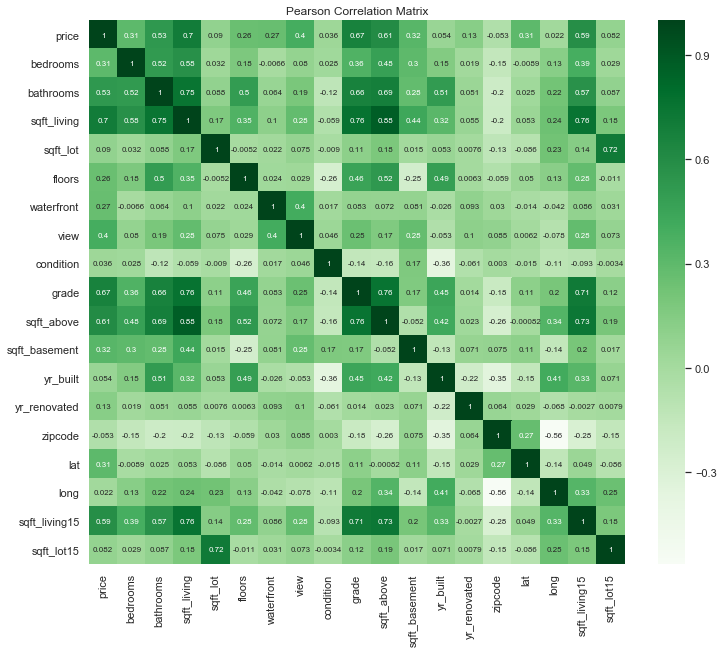

In [18]:
# Use Pearson correlation matrix
fig_1 = plt.figure(figsize=(12, 10))
new_correlations = df.corr()
sns.heatmap(new_correlations, annot=True, cmap='Greens', annot_kws={'size': 8})
plt.title('Pearson Correlation Matrix')
plt.show()

In [19]:
# Remove highly intercorrelated features
highly_correlated_features = new_correlations[new_correlations > 0.75]
print(highly_correlated_features.fillna('-'))
df = df.drop(['sqft_above', 'sqft_living15'], axis=1)



              price bedrooms bathrooms sqft_living sqft_lot floors waterfront  \
price             1        -         -           -        -      -          -   
bedrooms          -        1         -           -        -      -          -   
bathrooms         -        -         1    0.754665        -      -          -   
sqft_living       -        -  0.754665           1        -      -          -   
sqft_lot          -        -         -           -        1      -          -   
floors            -        -         -           -        -      1          -   
waterfront        -        -         -           -        -      -          1   
view              -        -         -           -        -      -          -   
condition         -        -         -           -        -      -          -   
grade             -        -         -    0.762704        -      -          -   
sqft_above        -        -         -    0.876597        -      -          -   
sqft_basement     -        -

From the matrix and the table shown above we can clearly see that there is a set of features which are highly corelated. sqft_above and sqft_living15. This will damper the results a bit as they are inter-related and using these would be a bit confusing. So, I dropped them.

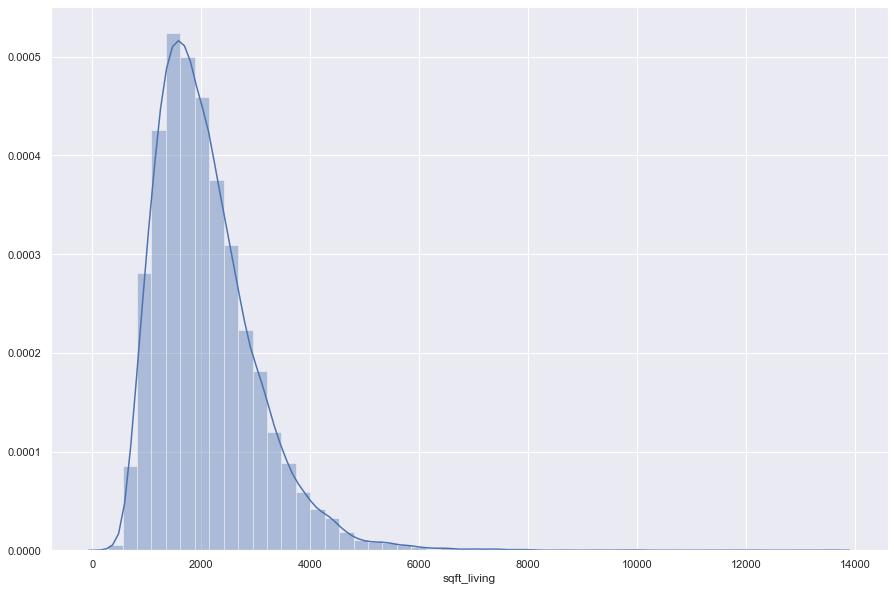

In [20]:
fig,axes = plt.subplots(nrows=1,ncols=1, figsize=(15,10))
sns.distplot(df['sqft_living'], hist=True, kde=True, rug=False, label='sqft_living', norm_hist=True)

In [21]:
# df_norm = (df - df.mean()) / (df.max() - df.min())
# df=df_norm
# df.head()
#df = df.drop(['sqft_above', 'sqft_living15'], axis=1)
df = df.drop(['condition','sqft_lot','zipcode', 'long', 'sqft_lot15'],axis=1)

In [22]:
df = df.drop('price',axis=1)

df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21613 entries, 0 to 21612
Data columns (total 11 columns):
bedrooms         21613 non-null int64
bathrooms        21613 non-null float64
sqft_living      21613 non-null int64
floors           21613 non-null float64
waterfront       21613 non-null int64
view             21613 non-null int64
grade            21613 non-null int64
sqft_basement    21613 non-null int64
yr_built         21613 non-null int64
yr_renovated     21613 non-null int64
lat              21613 non-null float64
dtypes: float64(3), int64(8)
memory usage: 1.8 MB


In [23]:
df.head()

,bedrooms,bathrooms,sqft_living,floors,waterfront,view,grade,sqft_basement,yr_built,yr_renovated,lat
0,3,1.00,1180,1.0,0,0,7,0,1955,0,47.5112
1,3,2.25,2570,2.0,0,0,7,400,1951,1991,47.7210
2,2,1.00,770,1.0,0,0,6,0,1933,0,47.7379
3,4,3.00,1960,1.0,0,0,7,910,1965,0,47.5208
4,3,2.00,1680,1.0,0,0,8,0,1987,0,47.6168


## Data Observation

From the data visualization and cleaning I observed that, 


Price the target variable has the gratest correlation with squareft living, sqft_living15 i.e. the square feet of the living room, grade and bathrooms. lat and bedrooms had some positive relation as well.

There are some dependecies that are observed from the graph like, sqft_living15 and grade had the best correlation. From the graphs mentioned above between the living_sqft15, grade and price, we could clearly see that grade and living_sqft15 are highly correlated. Also the same with the bedrooms and bathrooms with grade. 

From the correlation matrix we figured that there are some features which are not important for predicting the price fo the house like, sqft_lot, yr_built, sqft_lot15. So I dropped these columns. 

In [24]:
df.shape

(21613, 11)

### Neural Networks

Neural networks and deep learning are big topics in Computer Science and in the technology industry, they currently provide the best solutions to many problems in image recognition, speech recognition and natural language processing. 

The definition of a neural network, more properly referred to as an 'artificial' neural network (ANN), a computing system made up of a number of simple, highly interconnected processing elements, which process information by their dynamic state response to external inputs. 


** Neural Network Architecture **

 - Input Nodes : No computation is done here within this layer, the input is passed to the next layer
 
 - Hidden nodes : In this layer the intemediate processing or computation is done. It is possible to have a neural network without a hidden layer.
 
 - Output Nodes: The activation function is used here which maps to the desired output format.
 
 - weights and connections : The network consists of connections, each connection transferring the output of a neuron i to the input of a neuron j. In this sense i is the predecessor of j and j is the successor of i, Each connection is assigned a weight Wij.
 
 - Activation function : The main purpose of this is to introduce the non linearity to the network. There are several activation fucntions like sigmoid, tanh, ReLU
 
 

# III. Methods

## III.A 5-fold Cross Validation

Cross-validatation is a resampling procedure used to evaluate machine learning models on a limited data sample.

This procedure has a single parameter called as k which means the number of the groups that the test is going to partition into. 

This is mostly used in applied machine learning to determine the skill of a machine learning model on unseen data. The general steps to do this are as follows:
 - Shuffle the dataset at a random order
 - partition the dataset into k groups
 - for each group :
     - take one dataset out and set that as the test dataset
     - the remaining sets are clubbed to a train set
     - Fit a model using the train dataset and test it on the test set
     - Summarize the evaluation metrics
   

## Neural Network

In [25]:
# standardization class
class Standardizer: 
    """ class version of standardization """
    def __init__(self, X, explore=False):
        self._mu = np.mean(X,0)  
        self._sigma = np.std(X,0)
        if explore:
            print ("mean: ", self._mu)
            print ("sigma: ", self._sigma)
            print ("min: ", np.min(X,0))
            print ("max: ", np.max(X,0))

    def set_sigma(self, s):
        self._sigma[:] = s

    def standardize(self,X):
        return (X - self._mu) / self._sigma 

    def unstandardize(self,X):
        return (X * self._sigma) + self._mu

In [26]:
import numpy as np
import matplotlib.pyplot as plt
from grad import scg, steepest
from copy import copy
from util import Standardizer


class NeuralNet:
    """ neural network class for regression
        
        Parameters
        ----------
        nunits: list
            the number of inputs, hidden units, and outputs

        Methods
        -------
        set_hunit    
            update/initiate weights

        pack 
            pack multiple weights of each layer into one vector

        forward
            forward processing of neural network

        backward
            back-propagation of neural network

        train
            train the neural network

        use
            appply the trained network for prediction

        Attributes
        ----------
        _nLayers
            the number of hidden unit layers 

        rho
            learning rate

        _W
            weights
        _weights
            weights in one dimension (_W is referencing _weight)

        stdX
            standardization class for data
        stdT
            standardization class for target

        Notes
        -----
        
    """

    def __init__(self, nunits):

        self._nLayers=len(nunits)-1
        self.rho = [1] * self._nLayers
        self._W = []
        wdims = []
        lenweights = 0
        for i in range(self._nLayers):
            nwr = nunits[i] + 1
            nwc = nunits[i+1]
            wdims.append((nwr, nwc))
            lenweights = lenweights + nwr * nwc

        self._weights = np.random.uniform(-0.1,0.1, lenweights) 
        start = 0  # fixed index error 20110107
        for i in range(self._nLayers):
            end = start + wdims[i][0] * wdims[i][1] 
            self._W.append(self._weights[start:end])
            self._W[i].resize(wdims[i])
            start = end

        self.stdX = None
        self.stdT = None
        self.stdTarget = True

    def add_ones(self, w):
        return np.hstack((np.ones((w.shape[0], 1)), w))

    def get_nlayers(self):
        return self._nLayers

    def set_hunit(self, w):
        for i in range(self._nLayers-1):
            if w[i].shape != self._W[i].shape:
                print("set_hunit: shapes do not match!")
                break
            else:
                self._W[i][:] = w[i][:]

    def pack(self, w):
        return np.hstack(map(np.ravel, w))

    def unpack(self, weights):
        self._weights[:] = weights[:]  # unpack

    def cp_weight(self):
        return copy(self._weights)

    def RBF(self, X, m=None,s=None):
        if m is None: m = np.mean(X)
        if s is None: s = 2 #np.std(X)
        r = 1. / (np.sqrt(2*np.pi)* s)  
        return r * np.exp(-(X - m) ** 2 / (2 * s ** 2))

    def forward(self,X):
        t = X 
        Z = []

        for i in range(self._nLayers):
            Z.append(t) 
            if i == self._nLayers - 1:
                t = np.dot(self.add_ones(t), self._W[i])
            else:
                t = np.tanh(np.dot(self.add_ones(t), self._W[i]))
                #t = self.RBF(np.dot(np.hstack((np.ones((t.shape[0],1)),t)),self._W[i]))
        return (t, Z)
        
    def backward(self, error, Z, T, lmb=0):
        delta = error
        N = T.size
        dws = []
        for i in range(self._nLayers - 1, -1, -1):
            rh = float(self.rho[i]) / N
            if i==0:
                lmbterm = 0
            else:
                lmbterm = lmb * np.vstack((np.zeros((1, self._W[i].shape[1])),
                            self._W[i][1:,]))
            dws.insert(0,(-rh * np.dot(self.add_ones(Z[i]).T, delta) + lmbterm))
            if i != 0:
                delta = np.dot(delta, self._W[i][1:, :].T) * (1 - Z[i]**2)
        return self.pack(dws)

    def _errorf(self, T, Y):
        return T - Y
        
    def _objectf(self, T, Y, wpenalty):
        return 0.5 * np.mean(np.square(T - Y)) + wpenalty

    def train(self, X, T, **params):

        verbose = params.pop('verbose', False)
        # training parameters
        _lambda = params.pop('Lambda', 0.)

        #parameters for scg
        niter = params.pop('niter', 1000)
        wprecision = params.pop('wprecision', 1e-10)
        fprecision = params.pop('fprecision', 1e-10)
        wtracep = params.pop('wtracep', False)
        ftracep = params.pop('ftracep', False)

        # optimization
        optim = params.pop('optim', 'scg')

        if self.stdX == None:
            explore = params.pop('explore', False)
            self.stdX = Standardizer(X, explore)
        Xs = self.stdX.standardize(X)
        if self.stdT == None and self.stdTarget:
            self.stdT = Standardizer(T)
            T = self.stdT.standardize(T)
        
        def gradientf(weights):
            self.unpack(weights)
            Y,Z = self.forward(Xs)
            error = self._errorf(T, Y)
            return self.backward(error, Z, T, _lambda)
            
        def optimtargetf(weights):
            """ optimization target function : MSE 
            """
            self.unpack(weights)
            #self._weights[:] = weights[:]  # unpack
            Y,_ = self.forward(Xs)
            Wnb=np.array([])
            for i in range(self._nLayers):
                if len(Wnb)==0: Wnb=self._W[i][1:,].reshape(self._W[i].size-self._W[i][0,].size,1)
                else: Wnb = np.vstack((Wnb,self._W[i][1:,].reshape(self._W[i].size-self._W[i][0,].size,1)))
            wpenalty = _lambda * np.dot(Wnb.flat ,Wnb.flat)
            return self._objectf(T, Y, wpenalty)

        if optim == 'scg':
            result = scg(self.cp_weight(), gradientf, optimtargetf,
                                        wPrecision=wprecision, fPrecision=fprecision, 
                                        nIterations=niter,
                                        wtracep=wtracep, ftracep=ftracep,
                                        verbose=False)
            self.unpack(result['w'][:])
            self.f = result['f']
        elif optim == 'steepest':
            result = steepest(self.cp_weight(), gradientf, optimtargetf,
                                nIterations=niter,
                                xPrecision=wprecision, fPrecision=fprecision,
                                xtracep=wtracep, ftracep=ftracep )
            self.unpack(result['w'][:])
        if ftracep:
            self.ftrace = result['ftrace']
        if 'reason' in result.keys() and verbose:
            print(result['reason'])

        return result

    def use(self, X, retZ=False):
        if self.stdX:
            Xs = self.stdX.standardize(X)
        else:
            Xs = X
        Y, Z = self.forward(Xs)
        if self.stdT is not None:
            Y = self.stdT.unstandardize(Y)
        if retZ:
            return Y, Z
        return Y

### Explanation of codes

The above code has two classes one is Standardizer class and the other one is NeuralNet class.

 - The first class is used when you want to normalize a dataset. First the mean is calculated and min, max is collected from the dataset. Then using all these it normalizes the dataset. There is another function to denormalize the dataset too.
 
 - The second class is used to build a neural network which learns the data by feed forward and back propogation.
 
 - nunits gets the number of inputs, hidden units and outputs.
 
 - the set_hunit function is used when you want to update or initiate the weights.
 
 - Pack function is used to convert multiple weights of each layer into one vector.
 
 -  cp_weight function is used to copy all the weights and returns the copy vector
 
 - Forward function - The forward pass refers to calculation process, values of the output layers from the inputs data. It's traversing through all neurons from first to last layer.
 
 - Backward pass - backward pass refers to process of counting changes in weights (de facto learning), using gradient descent algorithm (or similar). Computation is made from last layer, backward to the first layer.
 
 - And the train function takes the input and target value. the gradient function is used to unpack the weights and it proceeds with the forward pass using the forward function. and loss is calculated and now proceeded to the backward pass, finally the back propogation is proceeded by calling the backward function.
 
 - the optimtarget function is used when you want to reduce the error by using the object function and updates the weights.
 
 - Use function is used to apply to the test data after training model is done. Testing data is then passed as parameter and standardizes the data. Later, forward pass is applied on the data which gives the prediction.
 
 - rho is the learning rate attribute of the class.
  
 - stdX and stdT are the standardization classes for data and target respectively.

In [27]:
from sklearn.metrics import mean_squared_error

## Cross Validation

In [28]:
#divides into parts of 20% of whole data. So resList will give five 20% of 100% of data
def partition(data):
    part = len(data) / 5.0
    reslist = []
    x = 0.0
    #Iterate through the length of s and keep on appending to resList so we've like 5 parts now and return the list
    while x < len(data):
        reslist.append(data[int(x):int(x + part)])
        x += part
    return reslist

f_list=[]
best_p_list=[]


def cross_validate(X, T, parameters):
    #Call partition and get the data partitioned
    X_div = partition(X)
    T_div = partition(T)
    
    #This loop iterates through all the 5 parts..so each i is like test data for the paritioned dataset 
    for i in range(5): 
        print("Test number: ",i)
        X_test = X_div[i]
        T_test = T_div[i]

        hrmse_list=[]
        p_list_local=[] 
        #best_param
        
        #k is the validation part of the 5 parts
        for k in range(5): 
            print("K fold is : ",k)
            if i == k: 
                continue 
            
            #Another 20% of data used
            X_val = X_div[k]
            T_val = T_div[k]
            
            #Train will be those which is not test and validation part. The remaining 60% of data of 100%
            X_train = X_div[not i and not k]
            T_train = T_div[not i and not k]
            
            l_param=[]
            l_rmse=[]
            for param in parameters:
                
                model = NeuralNet(param)
                model.train(X_train, T_train)
                pred = model.use(X_val)
                
                valid_error_val = np.sqrt(mean_squared_error(T_val, pred))
                l_rmse.append(valid_error_val)
                l_param.append(param)
                
            print(l_param)
            print(l_rmse)
            print(min(l_rmse))
            print(l_param[np.argmin(l_rmse)])
            hrmse_list.append(min(l_rmse))
            p_list_local.append(l_param[np.argmin(l_rmse)])
         
        print(p_list_local)
        print(hrmse_list)
        print(l_param[np.argmin(hrmse_list)])
        best_param=l_param[np.argmin(hrmse_list)]
        struct_best = NeuralNet(best_param)
        
        X_train = X_div[not i]
        T_train = T_div[not i]
        struct_best.train(X_train, T_train)

        prediction_f = struct_best.use(X_test)
        error_res = np.sqrt(mean_squared_error(T_test, prediction_f))
        f_list.append(error_res)
        best_p_list.append(best_param)

    return f_list,best_p_list

### Code Explanation

The first function is the partition function which is used to partition the data into 5 groups. Later, the data is iterated through the length of the dataset and keep on appending to a list which gives the result list. 

The second function is the cross_validate function which performs the task by taking the input X which has the sample, T contains the target values of the samples and model parameters as input. The function first divides the dataset into 5 parts as it is mentioned that it is a 5 fold cross validation using partition function. They are stored into X_div and T_div. f_list and best_p_list are returned in this function.

The function iterates through all the five parts and each set is used as a test data once, the rest is clubbed into the train dataset. All the sets are looped and each set would be a test case once.

In every validation loop, the data is trained with different sets of datasets. Each loop returns the rmse value and this is appended to the final rsme list with the indices.

from the history_rsme list we are picking the best result among the existing values, the result is applied to the model to the test set. Later, the accuracy is appended to the final list and parameters to the best p_list_local. From the results, we choose the parameters which is repeated more number of times in the list


### Presentation of the cross validation result

In [29]:
import warnings; warnings.simplefilter('ignore')
models = [[11,3,1],[11,4,1],[11,5,1], [11,6,1], [11,7,1]]

#print(df_target)

fine_accuracy,fine_parameters = cross_validate(np.array(df), np.array(df_target), models)

Test number:  0
K fold is :  0
K fold is :  1
[[11, 3, 1], [11, 4, 1], [11, 5, 1], [11, 6, 1], [11, 7, 1]]
[158788.97041846017, 171370.8735319008, 174233.34927121553, 171270.45011620905, 173674.85780701658]
158788.97041846017
[11, 3, 1]
K fold is :  2
[[11, 3, 1], [11, 4, 1], [11, 5, 1], [11, 6, 1], [11, 7, 1]]
[163883.9404850615, 173638.94399355442, 178778.03471875773, 154510.54903220347, 158509.96144803407]
154510.54903220347
[11, 6, 1]
K fold is :  3
[[11, 3, 1], [11, 4, 1], [11, 5, 1], [11, 6, 1], [11, 7, 1]]
[167297.90102107244, 166393.8132005818, 171583.8725317934, 176820.35512946598, 167072.56047235354]
166393.8132005818
[11, 4, 1]
K fold is :  4
[[11, 3, 1], [11, 4, 1], [11, 5, 1], [11, 6, 1], [11, 7, 1]]
[166947.31059705402, 167034.20237134758, 176307.27412564633, 177100.71796501573, 172237.88157846106]
166947.31059705402
[11, 3, 1]
[[11, 3, 1], [11, 6, 1], [11, 4, 1], [11, 3, 1]]
[158788.97041846017, 154510.54903220347, 166393.8132005818, 166947.31059705402]
[11, 4, 1]
Test n

In [30]:
from sklearn import model_selection

print(fine_accuracy,fine_parameters)

[166235.94627369326, 160032.87970273668, 180738.08550829734, 203533.95069175726, 167822.38247504173] [[11, 4, 1], [11, 3, 1], [11, 3, 1], [11, 3, 1], [11, 3, 1]]


In [31]:
X_train,X_test,y_train,y_test = model_selection.train_test_split(np.array(df),np.array(df_target),test_size=0.30,random_state=40)

In [32]:
model=NeuralNet([11,3,1])  
#choosing parameters which occured more number of times on the final parameter list
#because those are the list with mininmum rmse
model.train(X_train,y_train,niter=1000)

{'w': array([ 3.29504246e-01,  1.48427987e+00, -3.86369471e+00, -1.81076932e-02,
        -1.80556484e-02, -7.67718108e-02, -3.54502844e-03, -3.45493760e-02,
         2.90787481e-01,  7.63853758e-02, -8.96285953e-02,  1.19171475e-02,
         1.54352121e-02,  7.43520712e-02,  1.02749579e-01, -8.21298241e-03,
        -3.53735952e-02,  1.24783272e-01,  2.50853024e-02, -9.42422092e-03,
         4.52311576e-02,  8.61242855e-03, -1.98307361e-01,  3.59210540e-01,
        -1.08305670e-02,  1.43059485e-02,  1.47267043e-01,  3.26465470e-02,
         2.32790420e-01,  1.57734477e+00,  3.00169885e-03,  1.09477264e-02,
         5.41870335e-01,  4.31386996e-02, -6.09144631e-02,  3.06837498e-01,
         5.46188270e+00,  3.42681699e+00, -6.17203729e+00,  1.14512429e+00]),
 'f': 0.11836973081549243,
 'reason': 'reached limit of nIterations',
 'wtrace': None,
 'ftrace': None}

In [33]:
y_pred=model.use(X_test)


In [34]:
from sklearn.metrics import r2_score
print('RMSE:', np.sqrt(mean_squared_error(y_test, y_pred)))
print('R squared value:', r2_score(y_test, y_pred))

RMSE: 172640.81523841765
R squared value: 0.7681569357795532


### Plots of results

Text(0, 0.5, 'Price')

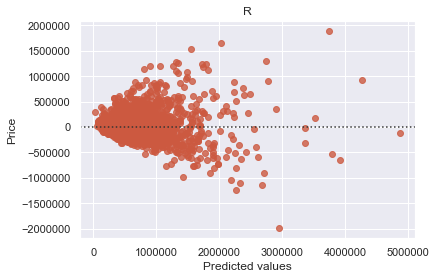

In [35]:
sns.residplot(y_pred.flatten(), y_test.flatten(), color=(0.8, 0.35, 0.25))
plt.title('R')
plt.xlabel('Predicted values')
plt.ylabel('Price')

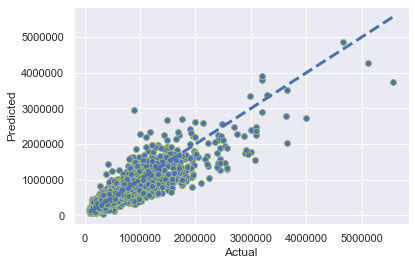

In [36]:
fig, ax = plt.subplots()
ax.scatter(y_test, y_pred, edgecolors=(0.6,0.7,0.5))
ax.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()],'b--', lw=3)
ax.set_ylabel('Predicted')
ax.set_xlabel('Actual')
plt.show()

Text(0.5, 1.0, 'NN model predictions')

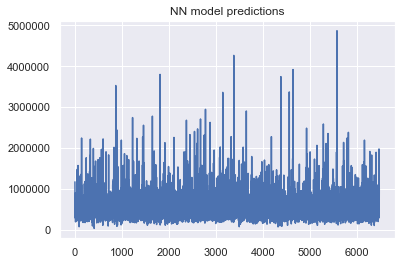

In [37]:
plt.plot(y_pred)
plt.title("NN model predictions")

## Discussions about parameter/network structure choice


## CV Results

In this assignment, 3 layer neural network is used. Input layer has 11 nodes as the number of features are 11 in the dataset. Output has 1 node.

Later, after 3 layer network I increased the number of layers and the results are better than I expected. I introduded upto 12 layers to my model and got better results.

I changed the number of nodes in the hidden layer. the parameters I passed were as follows [11,3,1],[11,5,1],[11,7,1], [11,10,1], [11,12,1]]. the first is the input features, the second one is the number of hidden layers and 1 output layer.

The results of the cross validation give that [11,3,1] is the model out of all with the rsme value.

From the results we can clearly see that the model with the number of hidden layer as 3 works better than the others. As the more number of nodes in hidden layer network it is overfitting the data.


## Discussions about the prediction results

In this assignment I have used neural networks and performed regression analysis. After performing the tasks I could get the optimal structure for the neural network as [11,3,1]. The RMSE came around 177316.4639758722 and R square value is 0.75.

The number of hidden layers varies to any number and each node is linked to the activation method which maked the network more powerful. tanh function is used as the activation function and the gradient is used for updating the weights in each layer while back propogation which made the netowk work well.

Using 11 layers and about 1000 iteration, the R squared value came around 0.75.

I expected with more number of layers the network would be strong but it actuallt became overfit and the best model layer came out to be the simple one i.e. 11,3,1.


## III.B Nonlinear Regression 

In statistics, nonlinear regression is a form of regression analysis in which observational data are modeled by a function which is a nonlinear combination of the model parameters and depends on one or more independent variables. The data are fitted by a method of successive approximations. 

Nonlinear regression uses nonlinear regression equations, which take the form:
Y = f(X,β) + ε
Where:

X = a vector of p predictors,
β = a vector of k parameters,
f(-) = a known regression function,
ε = an error term.



## Data

the dataset that I'm going to use for this assigment is adult income classification. I got this data from kaggle website. It consists of 15 columns with features like age, ID etc. This data comprises of the information about an individual with his/her education background, marital status, capital gain and loss, age and finally the target variable is the income class which tells us whether an individual belongs to class <=50K or >50K class. This dataset has about 30K values.

The features of the dataset are as follows: 

- age
- workclass
- fnlwgt
- education
- education.num
- marital.status
- occupation
- relationship
- race
- sex
- capital.gain
- capital.loss
- hours.per.week
- native.country
- income




In [38]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from collections import Counter
import seaborn as sns
%matplotlib inline

sns.set(style='white', context='notebook', palette='deep')

In [39]:
dataset = pd.read_csv("adult.csv")
dataset.describe()

,age,fnlwgt,education.num,capital.gain,capital.loss,hours.per.week
count,32561.000000,3.256100e+04,32561.000000,32561.000000,32561.000000,32561.000000
mean,38.581647,1.897784e+05,10.080679,1077.648844,87.303830,40.437456
std,13.640433,1.055500e+05,2.572720,7385.292085,402.960219,12.347429
min,17.000000,1.228500e+04,1.000000,0.000000,0.000000,1.000000
25%,28.000000,1.178270e+05,9.000000,0.000000,0.000000,40.000000
50%,37.000000,1.783560e+05,10.000000,0.000000,0.000000,40.000000
75%,48.000000,2.370510e+05,12.000000,0.000000,0.000000,45.000000
max,90.000000,1.484705e+06,16.000000,99999.000000,4356.000000,99.000000


In [40]:
printmd("### Missing values")
printmd("There are some missing values in the dataset. The following are the columns which have missing values and the count of the missing value")
for i,j in zip(dataset.columns,(dataset.values.astype(str) == '?').sum(axis = 0)):
    if j > 0:
        printmd(str(i) + ': ' + str(j) + ' records')
printmd("Now, the next part is figuring out if the data set has any missing values and replacing the missing values.")

### Missing values

There are some missing values in the dataset. The following are the columns which have missing values and the count of the missing value

workclass: 1836 records

occupation: 1843 records

native.country: 583 records

Now, the next part is figuring out if the data set has any missing values and replacing the missing values.

In [41]:
from ipykernel import kernelapp as app
printmd("1.deleting the data row.")
printmd(" This can be done if the missing data is <5% of the whole data")
printmd("2.fill the data with previous or next value")
printmd(" This is better than deleting the whole data set")
printmd("3.Reaplce the data with some constant value")
printmd("4.Replace with mean or median value")
printmd(" Out of all these I think the best option for my data is to go with option 2")
#printmd("#### Filling the missing values\n")
for i in range(0, len(dataset.workclass)):
    if dataset.workclass[i]=='?':
        dataset.workclass[i] = dataset.workclass[int(i)+1]
    if dataset.occupation[i]=='?':
        dataset.occupation[i] = dataset.occupation[int(i)+1]
    if dataset['native.country'][i]=='?':
        dataset['native.country'][i] = dataset['native.country'][i+1]


dataset.head(4)

1.deleting the data row.

 This can be done if the missing data is <5% of the whole data

2.fill the data with previous or next value

 This is better than deleting the whole data set

3.Reaplce the data with some constant value

4.Replace with mean or median value

 Out of all these I think the best option for my data is to go with option 2

,age,workclass,fnlwgt,education,education.num,marital.status,occupation,relationship,race,sex,capital.gain,capital.loss,hours.per.week,native.country,income
0,90,Private,77053,HS-grad,9,Widowed,Exec-managerial,Not-in-family,White,Female,0,4356,40,United-States,<=50K
1,82,Private,132870,HS-grad,9,Widowed,Exec-managerial,Not-in-family,White,Female,0,4356,18,United-States,<=50K
2,66,Private,186061,Some-college,10,Widowed,Machine-op-inspct,Unmarried,Black,Female,0,4356,40,United-States,<=50K
3,54,Private,140359,7th-8th,4,Divorced,Machine-op-inspct,Unmarried,White,Female,0,3900,40,United-States,<=50K


### Analyze Data

In [42]:
num_features = ['age','fnlwgt','education.num','capital.gain','capital.loss','hours.per.week','income']

categorical_features = ['workclass','education','marital.status','occupation','relationship','race','sex','native']




## Numerical Data Analysis

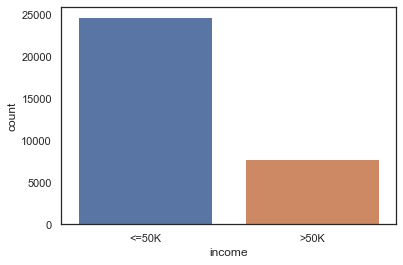

In [43]:
sns.countplot(dataset['income'],label="Count")
plt.show()

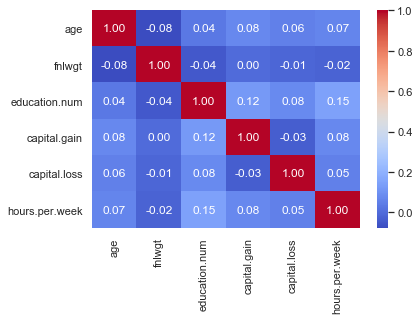

In [44]:
f = sns.heatmap(dataset[num_features].corr(), annot=True, fmt = ".2f", cmap = "coolwarm")
plt.show()

## Sex vs Income

Text(0, 0.5, 'population')

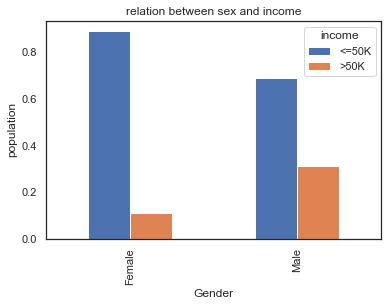

In [45]:
printmd('## Sex vs Income')
sex=round(pd.crosstab(dataset.sex,dataset.income).div(pd.crosstab(dataset.sex,dataset.income).apply(sum,1),0),2)
sex.sort_values(by = '>50K', inplace = True)
ax = sex.plot(kind='bar', title='relation between sex and income')
ax.set_xlabel('Gender')
ax.set_ylabel('population')

Text(17.246875000000003, 0.5, 'population')

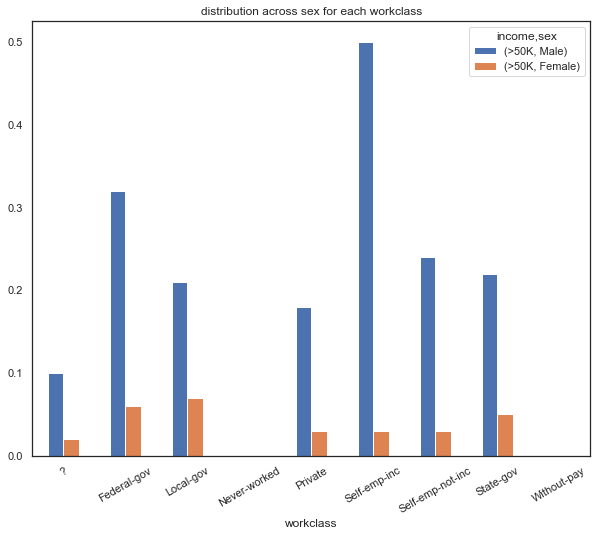

In [46]:
sex_wclass = round(pd.crosstab(dataset.workclass, [dataset.income, dataset.sex]).div(pd.crosstab(dataset.workclass, [dataset.income, dataset.sex]).apply(sum,1),0),2)
sex_wclass[[('>50K','Male'), ('>50K','Female')]].plot(kind = 'bar', title = 'distribution across sex for each workclass', figsize = (10,8), rot = 30)
ax.set_xlabel('Gender')
ax.set_ylabel('population')

## Income vs Occupation

Text(0, 0.5, 'Population')

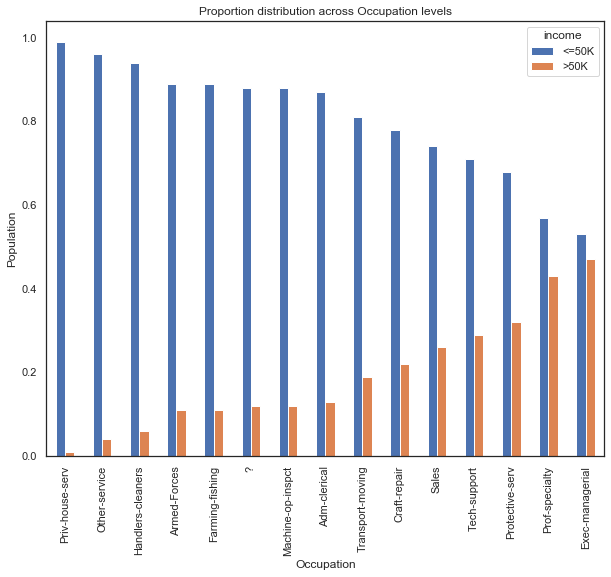

In [47]:
printmd("## Income vs Occupation")
occupation = round(pd.crosstab(dataset.occupation, dataset.income).div(pd.crosstab(dataset.occupation, dataset.income).apply(sum,1),0),2)
occupation.sort_values(by = '>50K', inplace = True)
ax = occupation.plot(kind ='bar', title = 'Proportion distribution across Occupation levels', figsize = (10,8))
ax.set_xlabel('Occupation')
ax.set_ylabel('Population')

## 2.4. Workclass vs Income

Text(0, 0.5, 'Proportion of population')

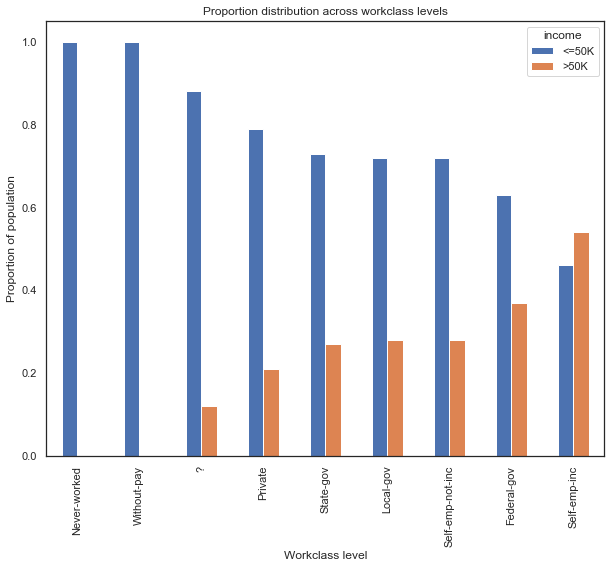

In [48]:
printmd('## 2.4. Workclass vs Income')

workclass = round(pd.crosstab(dataset.workclass, dataset.income).div(pd.crosstab(dataset.workclass, dataset.income).apply(sum,1),0),2)
workclass.sort_values(by = '>50K', inplace = True)
ax = workclass.plot(kind ='bar', title = 'Proportion distribution across workclass levels', figsize = (10,8))
ax.set_xlabel('Workclass level')
ax.set_ylabel('Proportion of population')

### Categorical Data Analysis

In [49]:
train = dataset

## 2.5. Race vs Income

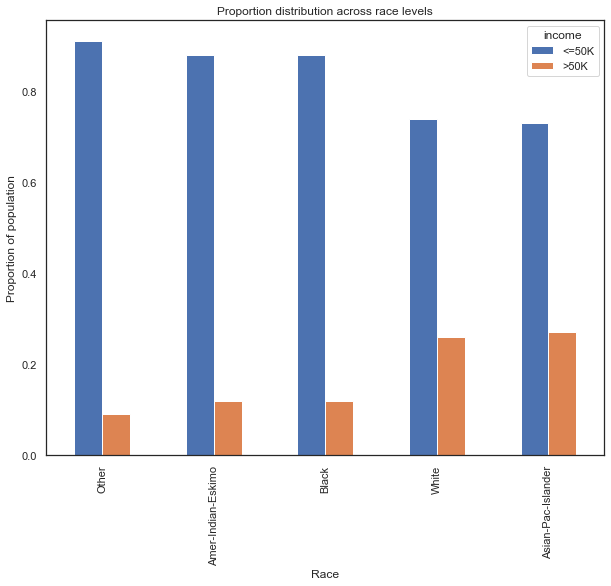

In [50]:
printmd('## 2.5. Race vs Income')

race = round(pd.crosstab(train.race, train.income).div(pd.crosstab(train.race, train.income).apply(sum,1),0),2)
race.sort_values(by = '>50K', inplace = True)
ax = race.plot(kind ='bar', title = 'Proportion distribution across race levels', figsize = (10,8))
ax.set_xlabel('Race')
ax.set_ylabel('Proportion of population')

print()

## 2.6. Native Country

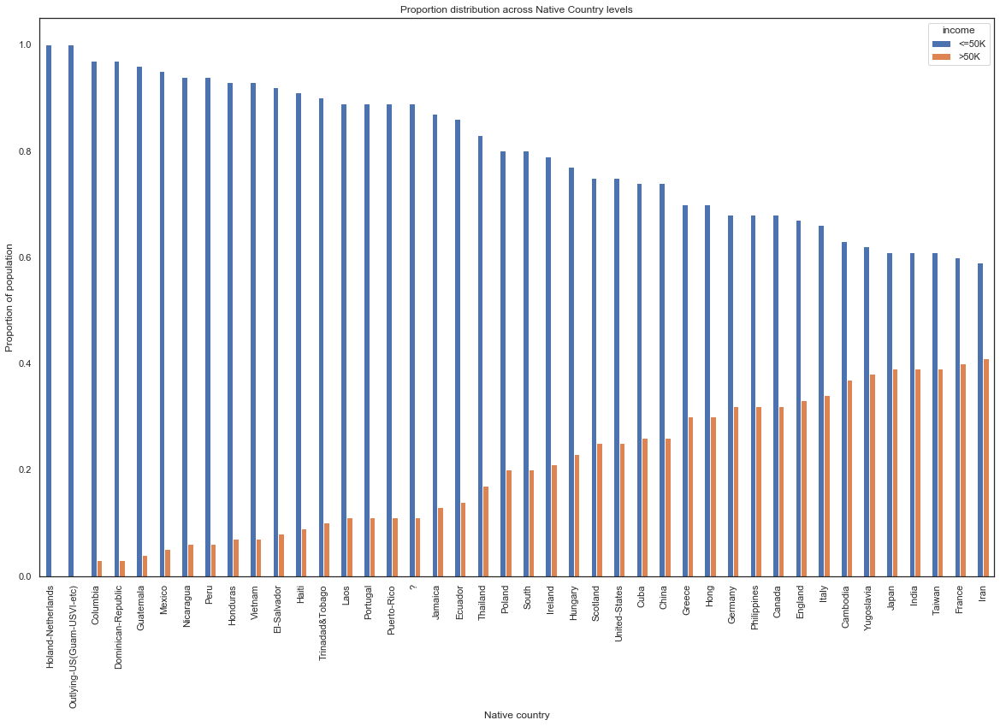

In [51]:
printmd('## 2.6. Native Country')

native_country = round(pd.crosstab(train['native.country'], train.income).div(pd.crosstab(train['native.country'], train.income).apply(sum,1),0),2)
native_country.sort_values(by = '>50K', inplace = True)
ax = native_country.plot(kind ='bar', title = 'Proportion distribution across Native Country levels', figsize = (20,12))
ax.set_xlabel('Native country')
ax.set_ylabel('Proportion of population')

print()

## 2.7. Hours per week vs Income

Text(0, 0.5, 'Proportion of population')

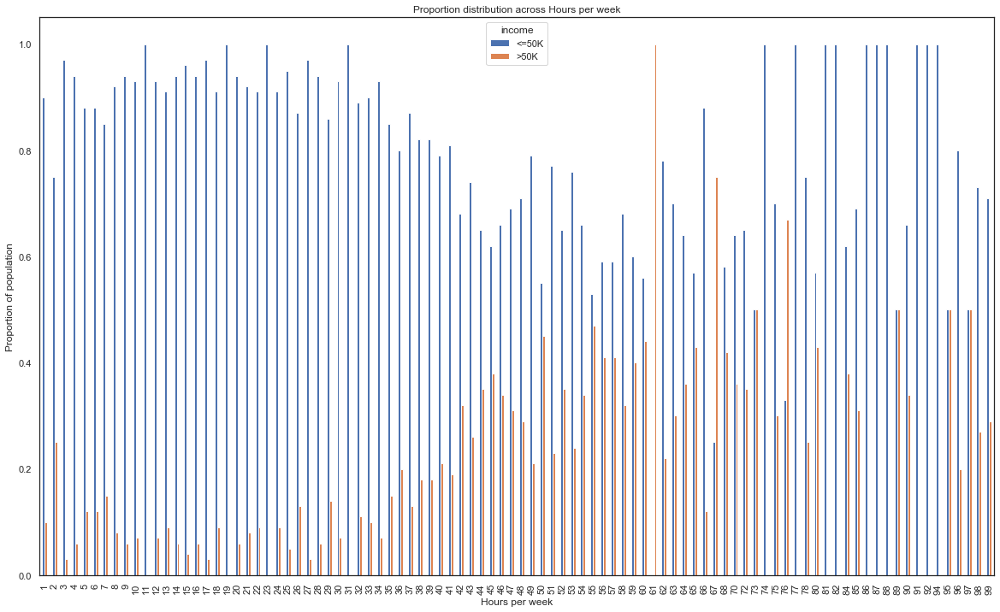

In [52]:
printmd('## 2.7. Hours per week vs Income')

hours_per_week = round(pd.crosstab(train['hours.per.week'], train.income).div(pd.crosstab(train['hours.per.week'], train.income).apply(sum,1),0),2)
# hours_per_week.sort_values(by = '>50K', inplace = True)
ax = hours_per_week.plot(kind ='bar', title = 'Proportion distribution across Hours per week', figsize = (20,12))
ax.set_xlabel('Hours per week')
ax.set_ylabel('Proportion of population')

In [53]:
dataset["sex"] = dataset["sex"].map({"Male": 0, "Female":1})

# Create Married Column - Binary Yes(1) or No(0)
dataset["marital.status"] = dataset["marital.status"].replace(['Never-married','Divorced','Separated','Widowed'], 'Single')
dataset["marital.status"] = dataset["marital.status"].replace(['Married-civ-spouse','Married-spouse-absent','Married-AF-spouse'], 'Married')
dataset["marital.status"] = dataset["marital.status"].map({"Married":1, "Single":0})
dataset["marital.status"] = dataset["marital.status"].astype(int)

# Drop the data you don't want to use
dataset.drop(labels=["workclass","education","occupation","relationship","race","native.country"], axis = 1, inplace = True)
print('Dataset with Dropped Labels')
print(dataset.head())

Dataset with Dropped Labels
   age  fnlwgt  education.num  marital.status  sex  capital.gain  \
0   90   77053              9               0    1             0   
1   82  132870              9               0    1             0   
2   66  186061             10               0    1             0   
3   54  140359              4               0    1             0   
4   41  264663             10               0    1             0   

   capital.loss  hours.per.week income  
0          4356              40  <=50K  
1          4356              18  <=50K  
2          4356              40  <=50K  
3          3900              40  <=50K  
4          3900              40  <=50K  


In [54]:
dataset['income'] = dataset['income'].map({'<=50K': -1, '>50K': 1})

dataset.head(4)

dataset.head()



,age,fnlwgt,education.num,marital.status,sex,capital.gain,capital.loss,hours.per.week,income
0,90,77053,9,0,1,0,4356,40,-1
1,82,132870,9,0,1,0,4356,18,-1
2,66,186061,10,0,1,0,4356,40,-1
3,54,140359,4,0,1,0,3900,40,-1
4,41,264663,10,0,1,0,3900,40,-1


In [55]:
dataset.shape

y_dataframe=dataset['income']
dataframe_lr=dataset.drop(['income'],axis=1)


## Premiliminary Observation

The dataset used in this part of the assignment has 32,562 records and the target variable is the income of the individual whether it lies in >50k class or <=50K class. There are 14 features in this set in which 8 are categircal and 6 are continuous. Out of all the features, continuous features didn't have that much of correlation with the target variable. Capital gain and loss have majority of zero values but only amlost 100 unique values. So, this means these are not that much helpful to predict the class. Education feature has a good relationship with the income class.

- Detailed Relation:
The following are the categorical features:
 - workclass 
 - education 
 - marital status 
 - occupation 
 - relationship 
 - race
 - sex
 - native country
 - income
The following are the numerical features:
 - age
 - education.num
 - capital.gain
 - capital.sum
 - hours.per.week
 
 
- **Sex vs Income:** 

the general view that can be understood from the observation is that the ration of males earning more than 50K per year is more than double of the females.

- **Workclass vs Income:**

Now if we compare the workclass against the male and female who earn more than 50K per year, we can see that men are always at higher propotion than women in almost all the classes expect without pay section.

- **Income vs occupation:**

The relation between occupation and income tells us that the occupations like Exec-managerial, prof-specality, Armed forces have higher paying jobs when compared to others like cleaners, farming, fishing. This helps us in narrowing the classes which are high paying and which are not.

- **Race vs Income:**

The observation between different races and income is as follows. Asian pac Islander has more ratio/count of having income grater than 50K when compared to other races. Also, people of American-Indian-Eskimo, Black, Others have almost similar ratio of income levels. White race level is middle with a ratio of almost 0.3 of >50K level.

- **Native Country vs Income:**

From the graph we can see that people from native country of South America,Thailand have lower ratio of >50K level when compared to people from countries in Europe and Asia like, France, India, England.

### Nonlinear Logistic Regression

Logistic regression is a special type of regression in which the goal is to model the probability of something as a function of other variables. While logistic regression makes core assumptions about the observations such as IID (each observation is independent of the others and they all have an identical probability distribution), the use of a linear decision boundary is not one of them. The linear decision boundary is used for reasons of simplicity following, when in doubt simplify. In those cases where we suspect the decision boundary to be nonlinear, it may make sense to formulate logistic regression with a nonlinear model and evaluate how much better we can do. 



In [56]:
from nn import NeuralNet

class NeuralNetLogReg(NeuralNet):
    """ Nonlinear Logistic Regression
    """

    # if you think, you need additional items to initialize here,
    # add your code for it here
    def __init__(self, nunits):
        NeuralNet.__init__(self, nunits)

    def softmax(self, z):
        if not isinstance(z, np.ndarray):
            z = np.asarray(z)
        expz = np.exp(z) 
        return expz / (np.sum(expz, axis=1, keepdims=True) if len(z.shape) == 2 else np.sum(expz))

    
    def forward(self, X):
        t = X 
        Z = []

        for i in range(self._nLayers):
            Z.append(t) 
            if i == self._nLayers - 1:
                t = np.dot(self.add_ones(t), self._W[i])
                t=self.softmax(t)
            else:
                t = np.tanh(np.dot(self.add_ones(t), self._W[i]))
        return (t, Z)
                

    # This is the error function that we want to minimize
    # what was it? take a look at the lecture note to fill in
    def _objectf(self, T, Y, wpenalty):
        return -(np.sum(T*(np.log(Y)))+wpenalty)

    # you must reuse the NeuralNet train since you already modified
    # the objective or error function (maybe both), 
    # you do not have many to change here.
    # MAKE SURE convert a vector label T to indicator matrix and 
    # feed that for training
    def train(self, X, T, **params):
        verbose = params.pop('verbose', False)
        # training parameters
        _lambda = params.pop('Lambda', 0.)

        #parameters for scg
        niter = params.pop('niter', 1000)
        wprecision = params.pop('wprecision', 1e-10)
        fprecision = params.pop('fprecision', 1e-10)
        wtracep = params.pop('wtracep', False)
        ftracep = params.pop('ftracep', False)

        # optimization
        optim = params.pop('optim', 'scg')
                
        def gradientf(weights):
            self.unpack(weights)
            Y,Z = self.forward(X)
            error = self._errorf(T, Y)
            return self.backward(error, Z, T, _lambda)
            
        def optimtargetf(weights):
            """ optimization target function : MSE 
            """
            self.unpack(weights)
            #self._weights[:] = weights[:]  # unpack
            Y,_ = self.forward(X)
            Wnb=np.array([])
            for i in range(self._nLayers):
                if len(Wnb)==0: Wnb=self._W[i][1:,].reshape(self._W[i].size-self._W[i][0,].size,1)
                else: Wnb = np.vstack((Wnb,self._W[i][1:,].reshape(self._W[i].size-self._W[i][0,].size,1)))
            wpenalty = _lambda * np.dot(Wnb.flat ,Wnb.flat)
            return self._objectf(T, Y, wpenalty)
            
        if optim == 'scg':
            result = scg(self.cp_weight(), gradientf, optimtargetf,
                                        wPrecision=wprecision, fPrecision=fprecision, 
                                        nIterations=niter,
                                        wtracep=wtracep, ftracep=ftracep,
                                        verbose=False)
            self.unpack(result['w'][:])
            self.f = result['f']
        elif optim == 'steepest':
            result = steepest(self.cp_weight(), gradientf, optimtargetf,
                                nIterations=niter,
                                xPrecision=wprecision, fPrecision=fprecision,
                                xtracep=wtracep, ftracep=ftracep )
            self.unpack(result['w'][:])
        if ftracep:
            self.ftrace = result['ftrace']
        if 'reason' in result.keys() and verbose:
            print(result['reason'])

    # going through forward pass, you will have the probabilities for each label
    # now, you can use argmax to find class labels
    # return both label and probabilities        
    def use(self, X):
        Y, Z = self.forward(X)
        l=np.argmax(Y,1)
        return Y,l

### Code Explanation

The only class here is the NeuralNetLogReg class which has many functions.

The first function is the init function which has the features of this class. This constructor class has the values like nLayers which defines the number of layers for the model. The next function is the forward function which uses tanh as the activation function and update the weights. The train function take the input as the features of the dataset. the gradientf method unpacks the wieghts and transfers to the forward pass by calling the forward function. After this the back propogation is started by calling the backpass function with the required parameters.


The only difference between the forward pass functions is that there is softmax layer added to the last layer which gives the output. 

The backward pass passes the function which takes the z values i.e. target values and the error as the input. The weights are also updated accordingly using the delta value. This function returns the weight vector which is packed together of a layer.

In [57]:
def add_ones(w):
    return np.hstack((np.ones((w.shape[0], 1)), w))

from sklearn.metrics import precision_score, recall_score, confusion_matrix, classification_report, accuracy_score, f1_score

from sklearn.preprocessing import StandardScaler
sc=StandardScaler()

from sklearn.metrics import roc_curve, auc

### Testing with Dummy data

Text(0.5, 1.0, 'test data set')

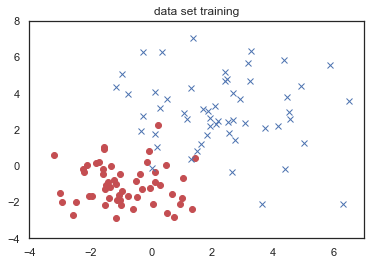

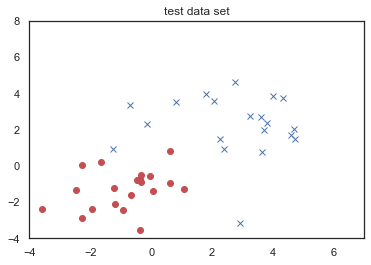

In [58]:
# Data for testing
N1 = 55
N2 = 55
N = N1 + N2
D = 2
K = 2

mu1 = [-1, -1]
cov1 = np.eye(2)

mu2 = [2,3]
cov2 = np.eye(2) * 3

#
#  Train Data
#
COV1 = np.random.multivariate_normal(mu1, cov1, N1)
COV2 = np.random.multivariate_normal(mu2, cov2, N2)

plt.plot(COV1[:, 0], COV1[:, 1], 'or')
plt.plot(COV2[:, 0], COV2[:, 1], 'xb')

plt.xlim([-4, 7])
plt.ylim([-4, 8])
plt.title("data set training")

Xtrain = np.vstack((COV1, COV2))
Ttrain = np.zeros((N, 1))
Ttrain[50:, :] = 1  # labels are zero or one

mean_val, stds = np.mean(Xtrain, 0), np.std(Xtrain, 0)
# normalize inputs
Xtrains = (Xtrain - mean_val) / stds

#
#  Test Data
#
Ctest1 = np.random.multivariate_normal(mu1, cov1, 20)
Ctest2 = np.random.multivariate_normal(mu2, cov2, 20)

Xtest = np.vstack((Ctest1, Ctest2))
Ttest = np.zeros((40, 1))
Ttest[20:, :] = 1

# normalize inputs
Xtests = (Xtrain - mean_val) / stds


plt.figure()
plt.plot(Ctest1[:, 0], Ctest1[:, 1], 'or')
plt.plot(Ctest2[:, 0], Ctest2[:, 1], 'xb')

plt.xlim([-4, 7])
plt.ylim([-4, 8])
plt.title("test data set")

In [59]:
clsf = NeuralNetLogReg([2, 4, 2])
clsf.train(Xtrain, Ttrain)
classes, Y = clsf.use(Xtest)

In [60]:
Y

array([1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0])

In [61]:
classes

array([[0.49990872, 0.50009128],
       [0.49778943, 0.50221057],
       [0.49964574, 0.50035426],
       [0.49893138, 0.50106862],
       [0.49812983, 0.50187017],
       [0.49942782, 0.50057218],
       [0.49900789, 0.50099211],
       [0.49996947, 0.50003053],
       [0.49818664, 0.50181336],
       [0.50037996, 0.49962004],
       [0.49815012, 0.50184988],
       [0.49947965, 0.50052035],
       [0.49951873, 0.50048127],
       [0.49838916, 0.50161084],
       [0.50291369, 0.49708631],
       [0.49998278, 0.50001722],
       [0.49866777, 0.50133223],
       [0.49970966, 0.50029034],
       [0.49865143, 0.50134857],
       [0.4983231 , 0.5016769 ],
       [0.50808084, 0.49191916],
       [0.50833834, 0.49166166],
       [0.50787445, 0.49212555],
       [0.50846751, 0.49153249],
       [0.50635757, 0.49364243],
       [0.50785449, 0.49214551],
       [0.50863021, 0.49136979],
       [0.50792906, 0.49207094],
       [0.50606378, 0.49393622],
       [0.5062298 , 0.4937702 ],
       [0.

Accuracy:  50.0 %


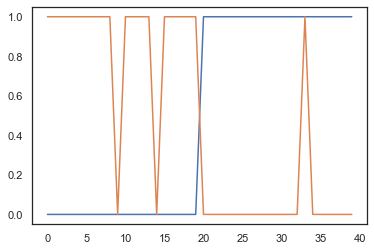

In [62]:
# retrieve labels and plot

plt.plot(Ttest)
plt.plot(Y)

print("Accuracy: ", 100 - np.mean(np.abs(Ttest - Y)) * 100, "%")

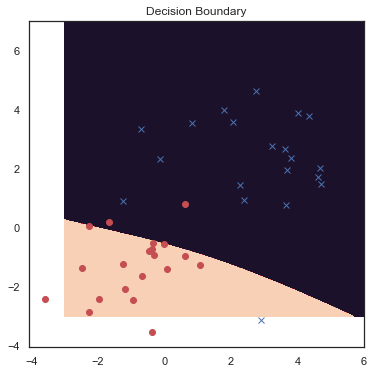

In [63]:
# show me the boundary

x = np.linspace(-3, 6, 1000)
y = np.linspace(-3, 7, 1000)

xs, ys = np.meshgrid(x, y)

X = np.vstack((xs.flat, ys.flat)).T
classes, _ = clsf.use(X)
zs = _.reshape(xs.shape)

plt.figure(figsize=(6,6))
plt.contourf(xs, ys, zs.reshape(xs.shape))
plt.title("Decision Boundary")

plt.plot(Ctest1[:, 0], Ctest1[:, 1], 'or')
plt.plot(Ctest2[:, 0], Ctest2[:, 1], 'xb')

### Discussion about dummy data
From the results, we can say that our NeuralNetLogReg class is working. As the accuracy is 50%


### Testing on classification dataset

In [64]:
XTrain, XTest, YTrain, YTest = model_selection.train_test_split(dataframe_lr, y_dataframe,test_size=0.20,random_state=42)

In [65]:
T = add_ones(np.array(YTrain).reshape(-1,1))
T=T.astype(int)
T[:,0]=T[:,1]
T[T[:,0]==1]=0
(T[:,1])[T[:,1]==0]=1
(T[:,0])[T[:,0]==-1]=1
T[T==-1]=0

In [66]:
nn = NeuralNetLogReg([8,4,2])
nn.train(sc.fit_transform(XTrain), T, niter=1000) 
p,l = nn.use(sc.fit_transform(XTest))

### Plots and results

In [67]:
y_test=np.where(YTest==-1,0,1)
print('F1 score:', f1_score(y_test, l))
print('Accuracy:', accuracy_score(y_test, l))

F1 score: 0.6401179941002949
Accuracy: 0.85014586212191


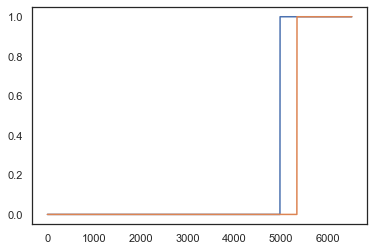

In [68]:
plt.plot(np.sort(y_test))
plt.plot(np.sort(l))

In [69]:
cf3=confusion_matrix(y_test, l)
cf3
TP=cf3[1][1]
TN=cf3[0][0]
FN=cf3[1][0]
FP=cf3[0][1]

In [70]:
precision=TP/(TP+FP)
specificity=TN/(TN+FP)
recall=TP/(TP+FN)

print('Precision: ' ,precision)
print('Specificity: ' ,specificity)
print('Recall: ' ,recall)

Precision:  0.7387234042553191
Specificity:  0.9383038585209004
Recall:  0.564736499674691


Text(0.5, 1, 'Confusion Matrix')

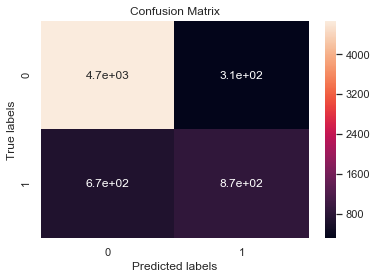

In [71]:
ax= plt.subplot()
sns.heatmap(cf3, annot=True, ax = ax);

ax.set_xlabel('Predicted labels');
ax.set_ylabel('True labels'); 
ax.set_title('Confusion Matrix')

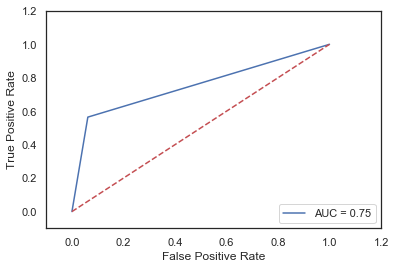

In [72]:
from sklearn.metrics import roc_curve, auc

false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, l)
roc_auc = auc(false_positive_rate, true_positive_rate)


##Plotting now
plt.plot(false_positive_rate, true_positive_rate, 'b',
label='AUC = %0.2f'% roc_auc)
plt.legend(loc='lower right')
plt.plot([0,1],[0,1],'r--')
plt.xlim([-0.1,1.2])
plt.ylim([-0.1,1.2])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

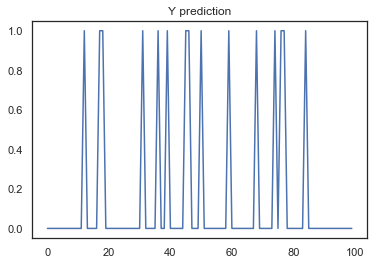

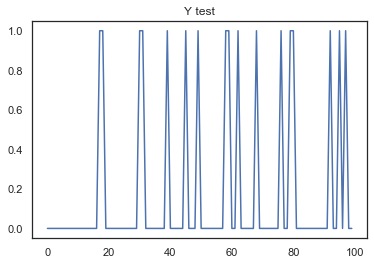

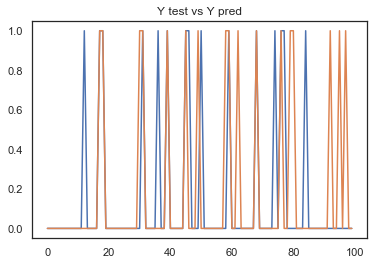

In [73]:
plt.title("Y prediction")
plt.plot(l[0:100])
plt.show()
plt.title("Y test")
plt.plot(np.array(y_test[0:100]))
plt.show()
plt.title("Y test vs Y pred")
plt.plot(l[0:100])
plt.plot(np.array(y_test[0:100]))
plt.show()

## CV for nonlinear logistic regression


In [74]:
def partition(s):
    avg = len(s) / 5.0
    out = []
    last = 0.0
    while last < len(s):
        out.append(s[int(last):int(last + avg)])
        last += avg
    return out

f_list=[]
best_p_list=[]
def cross_validate(X, T, parameters):
    partitionedX = partition(X)
    partitionedT = partition(T)
    for test in range(5): 
        print("test",test)
        Xtest = partitionedX[test]
        Ttest = partitionedT[test]
        j = 0
        
        h_rmse_list=[]
        params=[]
        for val in range(5): 
            print("val",val)
            if test == val: continue
            
            Xval = partitionedX[val]
            Tval = partitionedT[val]
            
            Xtrain = partitionedX[not test and not val]
            Ttrain = partitionedT[not test and not val]
            
            i = 0
            flist=[]
            p_list_local=[]
            for param in parameters:
                
                model = NeuralNetLogReg(param)
                model.train(Xtrain, Ttrain)
                prob,pred = model.use(Xval)
                Tval1=Tval[:,0]
                Tval1=np.where(Tval1==0,1,0)
                valAcc = f1_score(Tval1, pred)
                flist.append(valAcc)
                p_list_local.append(param)
            print(flist)
            print(p_list_local)
            #avg=sum(r_list_l)/len(r_list_l)
            #h_rmse_list.append(avg)
            print(max(flist))
            print(p_list_local[np.argmax(flist)])
            h_rmse_list.append(max(flist))
            params.append(p_list_local[np.argmax(flist)])
        print("h_rmse_list",h_rmse_list)
        print("params",params)
        #print(r_list_l)
        print(h_rmse_list)
        print(params)
        fine_parameters = params[np.argmax(h_rmse_list)]
        print(fine_parameters)
        bestModel = NeuralNetLogReg(fine_parameters)
        
        Xtrain = partitionedX[not test]
        Ttrain = partitionedT[not test]
        bestModel.train(Xtrain, Ttrain)

        prob1,finalPred = bestModel.use(Xtest)
        Ttest1=Ttest[:,0]
        Ttest1=np.where(Ttest1==0,1,0)
        myf1 = f1_score(Ttest1, finalPred)
        f_list.append(myf1)
        best_p_list.append(fine_parameters)

    return f_list,best_p_list

### code explanation

the only difference between the first cross validation and this one is that in this one I used f score to find the best score. Highest the f score better the model. 

In [75]:
T = add_ones(np.array(y_dataframe).reshape(-1,1))
T=T.astype(int)
T[:,0]=T[:,1]
T[T[:,0]==1]=0
(T[:,1])[T[:,1]==0]=1
(T[:,0])[T[:,0]==-1]=1
T[T==-1]=0

In [76]:
models = [[8,3,2], [8,5,2],[8,7,2], [8,9,2]]
fine_accuracy,fine_parameters = (cross_validate(np.array(dataframe_lr), T, models))

test 0
val 0
val 1
[0.0, 0.0, 0.0, 0.0]
[[8, 3, 2], [8, 5, 2], [8, 7, 2], [8, 9, 2]]
0.0
[8, 3, 2]
val 2
[0.0, 0.0, 0.0, 0.0]
[[8, 3, 2], [8, 5, 2], [8, 7, 2], [8, 9, 2]]
0.0
[8, 3, 2]
val 3
[0.0, 0.0, 0.0, 0.0]
[[8, 3, 2], [8, 5, 2], [8, 7, 2], [8, 9, 2]]
0.0
[8, 3, 2]
val 4
[0.0, 0.0, 0.0, 0.0]
[[8, 3, 2], [8, 5, 2], [8, 7, 2], [8, 9, 2]]
0.0
[8, 3, 2]
h_rmse_list [0.0, 0.0, 0.0, 0.0]
params [[8, 3, 2], [8, 3, 2], [8, 3, 2], [8, 3, 2]]
[0.0, 0.0, 0.0, 0.0]
[[8, 3, 2], [8, 3, 2], [8, 3, 2], [8, 3, 2]]
[8, 3, 2]
test 1
val 0
[0.0894736842105263, 0.00618131868131868, 0.0, 0.08695652173913043]
[[8, 3, 2], [8, 5, 2], [8, 7, 2], [8, 9, 2]]
0.0894736842105263
[8, 3, 2]
val 1
val 2
[0.0, 0.0, 0.0, 0.0]
[[8, 3, 2], [8, 5, 2], [8, 7, 2], [8, 9, 2]]
0.0
[8, 3, 2]
val 3
[0.0, 0.0, 0.0, 0.0]
[[8, 3, 2], [8, 5, 2], [8, 7, 2], [8, 9, 2]]
0.0
[8, 3, 2]
val 4
[0.0, 0.0, 0.0, 0.0]
[[8, 3, 2], [8, 5, 2], [8, 7, 2], [8, 9, 2]]
0.0
[8, 3, 2]
h_rmse_list [0.0894736842105263, 0.0, 0.0, 0.0]
params [[8, 3, 

### Final test with optimum parameters

In [77]:
print(fine_accuracy)
print(fine_parameters)

[0.09072978303747534, 0.0, 0.0, 0.0, 0.0]
[[8, 3, 2], [8, 3, 2], [8, 7, 2], [8, 5, 2], [8, 9, 2]]


In [78]:
T = add_ones(np.array(YTrain).reshape(-1,1))
T=T.astype(int)
T[:,0]=T[:,1]
T[T[:,0]==1]=0
(T[:,1])[T[:,1]==0]=1
(T[:,0])[T[:,0]==-1]=1
T[T==-1]=0

In [79]:
nn = NeuralNetLogReg([8,7,2])
nn.train(sc.fit_transform(XTrain), T,optim='scg') 
p,l = nn.use(sc.fit_transform(XTest))

In [80]:
y_pred1=l
y_test1=np.where(YTest==-1,0,1)
print('F1 score:', f1_score(y_test1, y_pred1))
print('Accuracy:', accuracy_score(y_test1, y_pred1))

F1 score: 0.6451133407655146
Accuracy: 0.8533701827115001


## Discussions about the parameter/network sturcture choice


In this part of the assignment I built a 7 layered neural network. Input layer has 8 nodes as the number of features are 8 in my dataset for this part. Also, the output layer has 2 nodes.

I've used multiple number of hidden layers and repeated the same process with multiple hidden layers. The model kept on giving better results as the layers increased but this might also be an overfitting prooblem As the highest layered module was the best fit for my network.

I tried finding the best structure by giving different values to the hidden layer part and performed the 5 fold cross validation. The results were as follows. [[8, 3, 2], [8, 3, 2], [8, 5, 2], [8, 7, 2], [8, 7, 2]]. The first value is the number of input nodes, the second one is the number of hidden layers and the last one is the number of output nodes.

From the results that I got from the cross validation the best structure is [8,7,2]. 

## Discussion about the prediction results

In this assignment, I've performed nonlinear logistic regression analysis using neural network. I've used NeuralNetLogReg to train the model with optimum structure as [8,7,2]. I got the f1 score for this model as 0.64365 and accuracy as 0.8526024873330262

As we can use how many number of hidden layers as we want, I got the optimum structure number as 7. Each node is connected to the activation function which makes the network more stronger than before. I used the softmax function for the last layer which the output layer. Also, the gradient fucntion is responsible for updating the weights in each layer.

I've used the number of hidden layers as 7 and I got the f1 score as 0.6436525612472161 and accuracy as 0.8526024873330262. As I was increasing the number of hidden layers the model kept on increasing which means the model was overfitting so I left at this number.

## Conclusions


In this assignment I got to learn about neural networks and k fold cross validation. I learned how neural networks help with a complex problem. Also, how neural networks becomes powerful and when to stop for the number of hidden layers for an optimum structure for the model. Also, another important thing that I've learned is how important it is to choose the parameters. Finally, I've also learned that making the model complex by increasing the number of hidden layers doesn't always give better neural network as it may overfit.

Challenges : applying cross validation from scratch was tough to implement, I faced some problems. 


## Extra Credit

In [81]:
df = pd.read_csv('kc_house_data.csv')


In [82]:
df = df.drop(['price'], axis=1)

In [83]:
df_target = pd.DataFrame(df.iloc[:,0])



In [84]:
df = df.drop(['id', 'date'], axis=1)

df = df.drop(['sqft_above', 'sqft_living15'], axis=1)
df = df.drop(['condition','sqft_lot','zipcode', 'long', 'sqft_lot15'],axis=1)

In [85]:
df.head()

,bedrooms,bathrooms,sqft_living,floors,waterfront,view,grade,sqft_basement,yr_built,yr_renovated,lat
0,3,1.00,1180,1.0,0,0,7,0,1955,0,47.5112
1,3,2.25,2570,2.0,0,0,7,400,1951,1991,47.7210
2,2,1.00,770,1.0,0,0,6,0,1933,0,47.7379
3,4,3.00,1960,1.0,0,0,7,910,1965,0,47.5208
4,3,2.00,1680,1.0,0,0,8,0,1987,0,47.6168


In [86]:
df.shape

(21613, 11)

In [87]:
df_target.shape

(21613, 1)

## Tanh

In [88]:
from grad import scg, steepest
from copy import copy


class NeuralNet:
    """ neural network class for regression
        
        Parameters
        ----------
        nunits: list
            the number of inputs, hidden units, and outputs

        Methods
        -------
        set_hunit    
            update/initiate weights

        pack 
            pack multiple weights of each layer into one vector

        forward
            forward processing of neural network

        backward
            back-propagation of neural network

        train
            train the neural network

        use
            appply the trained network for prediction

        Attributes
        ----------
        _nLayers
            the number of hidden unit layers 

        rho
            learning rate

        _W
            weights
        _weights
            weights in one dimension (_W is referencing _weight)

        stdX
            standardization class for data
        stdT
            standardization class for target

        Notes
        -----
        
    """

    def __init__(self, nunits):
        self._nLayers=len(nunits)-1
        self.rho = [1] * self._nLayers
        self._W = []
        wdims = []
        lenweights = 0
        for i in range(self._nLayers):
            nwr = nunits[i] + 1
            nwc = nunits[i+1]
            wdims.append((nwr, nwc))
            lenweights = lenweights + nwr * nwc

        self._weights = np.random.uniform(-0.1,0.1, lenweights) 
        start = 0  # fixed index error 20110107
        for i in range(self._nLayers):
            end = start + wdims[i][0] * wdims[i][1] 
            self._W.append(self._weights[start:end])
            self._W[i].resize(wdims[i])
            start = end

        self.stdX = None
        self.stdT = None
        self.stdTarget = True

    def add_ones(self, w):
        return np.hstack((np.ones((w.shape[0], 1)), w))

    def get_nlayers(self):
        return self._nLayers

    def set_hunit(self, w):
        for i in range(self._nLayers-1):
            if w[i].shape != self._W[i].shape:
                print("set_hunit: shapes do not match!")
                break
            else:
                self._W[i][:] = w[i][:]

    def pack(self, w):
        return np.hstack(map(np.ravel, w))

    def unpack(self, weights):
        self._weights[:] = weights[:]  # unpack

    def cp_weight(self):
        return copy(self._weights)

    def RBF(self, X, m=None,s=None):
        if m is None: m = np.mean(X)
        if s is None: s = 2 #np.std(X)
        r = 1. / (np.sqrt(2*np.pi)* s)  
        return r * np.exp(-(X - m) ** 2 / (2 * s ** 2))
    
    def Sigma(self, X):
        return (1/(1+(np.exp(-(X)))))

    def forward(self,X):
        t = X 
        Z = []

        for i in range(self._nLayers):
            Z.append(t) 
            if i == self._nLayers - 1:
                t = np.dot(self.add_ones(t), self._W[i])
            else:
                t = np.tanh(np.dot(self.add_ones(t), self._W[i]))
                
        return (t, Z)
        
    def backward(self, error, Z, T, lmb=0):
        delta = error
        N = T.size
        dws = []
        for i in range(self._nLayers - 1, -1, -1):
            rh = float(self.rho[i]) / N
            if i==0:
                lmbterm = 0
            else:
                lmbterm = lmb * np.vstack((np.zeros((1, self._W[i].shape[1])),
                            self._W[i][1:,]))
                
            #print(Z[i].T.shape)
            dws.insert(0,(-rh * np.dot(self.add_ones(Z[i]).T, delta) + lmbterm))
            if i != 0:
                delta = np.dot(delta, self._W[i][1:, :].T) * (1 - Z[i]**2)
        return self.pack(dws)

    def _errorf(self, T, Y):
        return T - Y
        
    def _objectf(self, T, Y, wpenalty):
        return 0.5 * np.mean(np.square(T - Y)) + wpenalty

    def train(self, X, T, **params):

        verbose = params.pop('verbose', False)
        # training parameters
        _lambda = params.pop('Lambda', 0.)

        #parameters for scg
        niter = params.pop('niter', 1000)
        wprecision = params.pop('wprecision', 1e-10)
        fprecision = params.pop('fprecision', 1e-10)
        wtracep = params.pop('wtracep', False)
        ftracep = params.pop('ftracep', False)

        # optimization
        optim = params.pop('optim', 'scg')

        if self.stdX == None:
            explore = params.pop('explore', False)
            self.stdX = Standardizer(X, explore)
        Xs = self.stdX.standardize(X)
        if self.stdT == None and self.stdTarget:
            self.stdT = Standardizer(T)
            T = self.stdT.standardize(T)
        
        def gradientf(weights):
            self.unpack(weights)
            Y,Z = self.forward(Xs)
            
            error = self._errorf(T, Y)
            return self.backward(error, Z, T, _lambda)
            
        def optimtargetf(weights):
            """ optimization target function : MSE 
            """
            self.unpack(weights)
            #self._weights[:] = weights[:]  # unpack
            Y,_ = self.forward(Xs)
            Wnb=np.array([])
            for i in range(self._nLayers):
                if len(Wnb)==0: Wnb=self._W[i][1:,].reshape(self._W[i].size-self._W[i][0,].size,1)
                else: Wnb = np.vstack((Wnb,self._W[i][1:,].reshape(self._W[i].size-self._W[i][0,].size,1)))
            wpenalty = _lambda * np.dot(Wnb.flat ,Wnb.flat)
            return self._objectf(T, Y, wpenalty)

        if optim == 'scg':
            result = scg(self.cp_weight(), gradientf, optimtargetf,
                                        wPrecision=wprecision, fPrecision=fprecision, 
                                        nIterations=niter,
                                        wtracep=wtracep, ftracep=ftracep,
                                        verbose=False)
            self.unpack(result['w'][:])
            self.f = result['f']
        elif optim == 'steepest':
            result = steepest(self.cp_weight(), gradientf, optimtargetf,
                                nIterations=niter,
                                xPrecision=wprecision, fPrecision=fprecision,
                                xtracep=wtracep, ftracep=ftracep )
            self.unpack(result['w'][:])
        if ftracep:
            self.ftrace = result['ftrace']
        if 'reason' in result.keys() and verbose:
            print(result['reason'])

        return result

    def use(self, X, retZ=False):
        if self.stdX:
            Xs = self.stdX.standardize(X)
        else:
            Xs = X
        Y, Z = self.forward(Xs)
        if self.stdT is not None:
            Y = self.stdT.unstandardize(Y)
        if retZ:
            return Y, Z
        return Y


In [89]:
#Splits into parts of 20% of whole data. So resList will give five 20% of 100% of data
def partition(data):
    part = len(data) / 5.0
    reslist = []
    x = 0.0
    #Iterate through the length of s and keep on appending to resList so we've like 5 parts now and return the list
    while x < len(data):
        reslist.append(data[int(x):int(x + part)])
        x += part
    return reslist

best_p_list=[]
f_list=[]

def cross_validate(X, T, parameters):
    #Call Split and get the data partitioned
    X_div = partition(X)
    T_div = partition(T)
    
    #This loop iterates through all the 5 parts..so each i is like test data for the paritioned dataset 
    for i in range(5): 
        print("Test number: ",i)
        X_test = X_div[i]
        T_test = T_div[i]

        h_rmse_list=[]
        params=[] 
        #best_param
        
        #k is the validation part of the 5 parts
        for k in range(5): 
            print("K is : ",k)
            if i == k: 
                continue 
            
            #Another 20% of data used
            X_val = X_div[k]
            T_val = T_div[k]
            
            #Train will be those which is not test and validation part. The remaining 60% of data of 100%
            X_train = X_div[not i and not k]
            T_train = T_div[not i and not k]
            
            #m = 0
            p_list_local=[]
            r_list_l=[]
            for param in parameters:
                
                model = NeuralNet(param)
                model.train(X_train, T_train)
                pred = model.use(X_val)
                
                valid_err = np.sqrt(mean_squared_error(T_val, pred))
                r_list_l.append(valid_err)
                p_list_local.append(param)
                
            print(p_list_local)
            print(r_list_l)
            print(min(r_list_l))
            print(p_list_local[np.argmin(r_list_l)])
            h_rmse_list.append(min(r_list_l))
            params.append(p_list_local[np.argmin(r_list_l)])
         
        print(params)
        print(h_rmse_list)
        print(p_list_local[np.argmin(h_rmse_list)])
        best_param=p_list_local[np.argmin(h_rmse_list)]
        struct_best = NeuralNet(best_param)
        
        X_train = X_div[not i]
        T_train = T_div[not i]
        struct_best.train(X_train, T_train)

        prediction_f = struct_best.use(X_test)
        error_res = np.sqrt(mean_squared_error(T_test, prediction_f))
        f_list.append(error_res)
        best_p_list.append(best_param)

    return f_list,best_p_list

In [90]:
models = [[11,3,1],[11,5,1],[11,7,1], [11,10,1], [11,12,1]]

fine_accuracy,fine_parameters = cross_validate(np.array(df), np.array(df_target), models)

Test number:  0
K is :  0
K is :  1
[[11, 3, 1], [11, 5, 1], [11, 7, 1], [11, 10, 1], [11, 12, 1]]
[2872814552.1412373, 2896580802.7389874, 2920980192.574317, 2922139900.3914633, 2994903891.974395]
2872814552.1412373
[11, 3, 1]
K is :  2
[[11, 3, 1], [11, 5, 1], [11, 7, 1], [11, 10, 1], [11, 12, 1]]
[2864895582.9742727, 2872776131.8908787, 2913898476.461586, 2919794672.618619, 2977854989.0945377]
2864895582.9742727
[11, 3, 1]
K is :  3
[[11, 3, 1], [11, 5, 1], [11, 7, 1], [11, 10, 1], [11, 12, 1]]
[2892831750.755212, 2931219424.2017145, 2911601403.912056, 2959144320.5254445, 2967777523.536192]
2892831750.755212
[11, 3, 1]
K is :  4
[[11, 3, 1], [11, 5, 1], [11, 7, 1], [11, 10, 1], [11, 12, 1]]
[2958219170.4860535, 2965862036.010608, 3009732217.4933176, 3025444944.386981, 3009921148.2380543]
2958219170.4860535
[11, 3, 1]
[[11, 3, 1], [11, 3, 1], [11, 3, 1], [11, 3, 1]]
[2872814552.1412373, 2864895582.9742727, 2892831750.755212, 2958219170.4860535]
[11, 5, 1]
Test number:  1
K is :  0
[[

In [91]:
from sklearn import model_selection

print(fine_accuracy,fine_parameters)


[2916083698.550195, 2856321897.6807766, 2869934695.422848, 2883473026.257918, 2951206714.244558] [[11, 5, 1], [11, 3, 1], [11, 3, 1], [11, 3, 1], [11, 3, 1]]


In [92]:
X_train,X_test,y_train,y_test = model_selection.train_test_split(np.array(df),np.array(df_target),test_size=0.30,random_state=40)

In [93]:
model=NeuralNet([11,3,1])  
#choosing parameters which occured more number of times on the final parameter list
#because those are the list with mininmum rmse
model.train(X_train,y_train,niter=1000)

{'w': array([-0.17720375, -0.17460147,  7.91123998, -0.22932442, -0.34549895,
        -1.79425408, -0.58249884, -0.71219078, -0.59085761, -0.21304245,
        -0.11634769,  1.14683559,  0.54668763,  0.58636686, -0.81129594,
         0.2873971 ,  0.30182622,  0.01774432, -0.22391631, -0.27188715,
         0.96232219,  0.15885556,  0.11505039, -2.24008481,  0.23307541,
         0.27495739, -0.29547485, -0.67917281, -0.88467821, -0.96639564,
        -0.04103123, -0.03664542,  0.44269828,  1.06316181,  1.08071908,
        -6.65220151, -0.12913727,  1.24523676, -1.20034357,  0.1875961 ]),
 'f': 0.4912199891267208,
 'reason': 'reached limit of nIterations',
 'wtrace': None,
 'ftrace': None}

In [94]:
y_pred=model.use(X_test)

In [95]:
from sklearn.metrics import r2_score
print('RMSE:', np.sqrt(mean_squared_error(y_test, y_pred)))
print('R squared value:', r2_score(y_test, y_pred))

RMSE: 2866700888.77914
R squared value: 0.002492680034264283


## ReLU

In [96]:
from grad import scg, steepest
from copy import copy


class NeuralNet:
    """ neural network class for regression
        
        Parameters
        ----------
        nunits: list
            the number of inputs, hidden units, and outputs

        Methods
        -------
        set_hunit    
            update/initiate weights

        pack 
            pack multiple weights of each layer into one vector

        forward
            forward processing of neural network

        backward
            back-propagation of neural network

        train
            train the neural network

        use
            appply the trained network for prediction

        Attributes
        ----------
        _nLayers
            the number of hidden unit layers 

        rho
            learning rate

        _W
            weights
        _weights
            weights in one dimension (_W is referencing _weight)

        stdX
            standardization class for data
        stdT
            standardization class for target

        Notes
        -----
        
    """

    def __init__(self, nunits):
        self._nLayers=len(nunits)-1
        self.rho = [1] * self._nLayers
        self._W = []
        wdims = []
        lenweights = 0
        for i in range(self._nLayers):
            nwr = nunits[i] + 1
            nwc = nunits[i+1]
            wdims.append((nwr, nwc))
            lenweights = lenweights + nwr * nwc

        self._weights = np.random.uniform(-0.1,0.1, lenweights) 
        start = 0  # fixed index error 20110107
        for i in range(self._nLayers):
            end = start + wdims[i][0] * wdims[i][1] 
            self._W.append(self._weights[start:end])
            self._W[i].resize(wdims[i])
            start = end

        self.stdX = None
        self.stdT = None
        self.stdTarget = True

    def add_ones(self, w):
        return np.hstack((np.ones((w.shape[0], 1)), w))

    def get_nlayers(self):
        return self._nLayers

    def set_hunit(self, w):
        for i in range(self._nLayers-1):
            if w[i].shape != self._W[i].shape:
                print("set_hunit: shapes do not match!")
                break
            else:
                self._W[i][:] = w[i][:]

    def pack(self, w):
        return np.hstack(map(np.ravel, w))

    def unpack(self, weights):
        self._weights[:] = weights[:]  # unpack

    def cp_weight(self):
        return copy(self._weights)

    def RBF(self, X, m=None,s=None):
        if m is None: m = np.mean(X)
        if s is None: s = 2 #np.std(X)
        r = 1. / (np.sqrt(2*np.pi)* s)  
        return r * np.exp(-(X - m) ** 2 / (2 * s ** 2))
    
    def Sigma(self, X):
        return (1/(1+(np.exp(-(X)))))
    
    def dSigma(self, X):
        return ((np.exp(-x))/(1+(np.exp(-x)))^2)
    
    def ReLU(self, x):
        return x * (x > 0)

    def dReLU(self, x):
        return 1. * (x > 0)

    def forward(self,X):
        t = X 
        Z = []

        for i in range(self._nLayers):
            Z.append(t) 
            if i == self._nLayers - 1:
                t = np.dot(self.add_ones(t), self._W[i])
            else:
                t = self.ReLU(np.dot(self.add_ones(t), self._W[i]))
                
        return (t, Z)
        
    def backward(self, error, Z, T, lmb=0):
        delta = error
        N = T.size
        dws = []
        for i in range(self._nLayers - 1, -1, -1):
            rh = float(self.rho[i]) / N
            if i==0:
                lmbterm = 0
            else:
                lmbterm = lmb * np.vstack((np.zeros((1, self._W[i].shape[1])),
                            self._W[i][1:,]))
                
            #print(Z[i].T.shape)
            dws.insert(0,(-rh * np.dot(self.add_ones(Z[i]).T, delta) + lmbterm))
            if i != 0:
                delta = np.dot(delta, self._W[i][1:, :].T) * (1. * Z[i])
        return self.pack(dws)

    def _errorf(self, T, Y):
        return T - Y
        
    def _objectf(self, T, Y, wpenalty):
        return 0.5 * np.mean(np.square(T - Y)) + wpenalty

    def train(self, X, T, **params):

        verbose = params.pop('verbose', False)
        # training parameters
        _lambda = params.pop('Lambda', 0.)

        #parameters for scg
        niter = params.pop('niter', 1000)
        wprecision = params.pop('wprecision', 1e-10)
        fprecision = params.pop('fprecision', 1e-10)
        wtracep = params.pop('wtracep', False)
        ftracep = params.pop('ftracep', False)

        # optimization
        optim = params.pop('optim', 'scg')

        if self.stdX == None:
            explore = params.pop('explore', False)
            self.stdX = Standardizer(X, explore)
        Xs = self.stdX.standardize(X)
        if self.stdT == None and self.stdTarget:
            self.stdT = Standardizer(T)
            T = self.stdT.standardize(T)
        
        def gradientf(weights):
            self.unpack(weights)
            Y,Z = self.forward(Xs)
            
            error = self._errorf(T, Y)
            return self.backward(error, Z, T, _lambda)
            
        def optimtargetf(weights):
            """ optimization target function : MSE 
            """
            self.unpack(weights)
            #self._weights[:] = weights[:]  # unpack
            Y,_ = self.forward(Xs)
            Wnb=np.array([])
            for i in range(self._nLayers):
                if len(Wnb)==0: Wnb=self._W[i][1:,].reshape(self._W[i].size-self._W[i][0,].size,1)
                else: Wnb = np.vstack((Wnb,self._W[i][1:,].reshape(self._W[i].size-self._W[i][0,].size,1)))
            wpenalty = _lambda * np.dot(Wnb.flat ,Wnb.flat)
            return self._objectf(T, Y, wpenalty)

        if optim == 'scg':
            result = scg(self.cp_weight(), gradientf, optimtargetf,
                                        wPrecision=wprecision, fPrecision=fprecision, 
                                        nIterations=niter,
                                        wtracep=wtracep, ftracep=ftracep,
                                        verbose=False)
            self.unpack(result['w'][:])
            self.f = result['f']
        elif optim == 'steepest':
            result = steepest(self.cp_weight(), gradientf, optimtargetf,
                                nIterations=niter,
                                xPrecision=wprecision, fPrecision=fprecision,
                                xtracep=wtracep, ftracep=ftracep )
            self.unpack(result['w'][:])
        if ftracep:
            self.ftrace = result['ftrace']
        if 'reason' in result.keys() and verbose:
            print(result['reason'])

        return result

    def use(self, X, retZ=False):
        if self.stdX:
            Xs = self.stdX.standardize(X)
        else:
            Xs = X
        Y, Z = self.forward(Xs)
        if self.stdT is not None:
            Y = self.stdT.unstandardize(Y)
        if retZ:
            return Y, Z
        return Y

In [97]:
#Splits into parts of 20% of whole data. So resList will give five 20% of 100% of data
def partition(data):
    part = len(data) / 5.0
    reslist = []
    x = 0.0
    #Iterate through the length of s and keep on appending to resList so we've like 5 parts now and return the list
    while x < len(data):
        reslist.append(data[int(x):int(x + part)])
        x += part
    return reslist

best_p_list=[]
f_list=[]

def cross_validate(X, T, parameters):
    #Call Split and get the data partitioned
    X_div = partition(X)
    T_div = partition(T)
    
    #This loop iterates through all the 5 parts..so each i is like test data for the paritioned dataset 
    for i in range(5): 
        print("Test number: ",i)
        X_test = X_div[i]
        T_test = T_div[i]

        h_rmse_list=[]
        params=[] 
        #best_param
        
        #k is the validation part of the 5 parts
        for k in range(5): 
            print("K is : ",k)
            if i == k: 
                continue 
            
            #Another 20% of data used
            X_val = X_div[k]
            T_val = T_div[k]
            
            #Train will be those which is not test and validation part. The remaining 60% of data of 100%
            X_train = X_div[not i and not k]
            T_train = T_div[not i and not k]
            
            #m = 0
            p_list_local=[]
            r_list_l=[]
            for param in parameters:
                
                model = NeuralNet(param)
                model.train(X_train, T_train)
                pred = model.use(X_val)
                
                valid_err = np.sqrt(mean_squared_error(T_val, pred))
                r_list_l.append(valid_err)
                p_list_local.append(param)
                
            print(p_list_local)
            print(r_list_l)
            print(min(r_list_l))
            print(p_list_local[np.argmin(r_list_l)])
            h_rmse_list.append(min(r_list_l))
            params.append(p_list_local[np.argmin(r_list_l)])
         
        print(params)
        print(h_rmse_list)
        print(p_list_local[np.argmin(h_rmse_list)])
        best_param=p_list_local[np.argmin(h_rmse_list)]
        struct_best = NeuralNet(best_param)
        
        X_train = X_div[not i]
        T_train = T_div[not i]
        struct_best.train(X_train, T_train)

        prediction_f = struct_best.use(X_test)
        error_res = np.sqrt(mean_squared_error(T_test, prediction_f))
        f_list.append(error_res)
        best_p_list.append(best_param)

    return f_list,best_p_list

In [98]:
models = [[11,3,1],[11,5,1],[11,7,1], [11,10,1], [11,12,1]]

fine_accuracy,fine_parameters = cross_validate(np.array(df), np.array(df_target), models)

Test number:  0
K is :  0
K is :  1
[[11, 3, 1], [11, 5, 1], [11, 7, 1], [11, 10, 1], [11, 12, 1]]
[2856817773.7213554, 2862205677.3088927, 2869566141.8457913, 2860643450.3476315, 2865985309.7768154]
2856817773.7213554
[11, 3, 1]
K is :  2
[[11, 3, 1], [11, 5, 1], [11, 7, 1], [11, 10, 1], [11, 12, 1]]
[2859451082.7504663, 2855732918.3478622, 2849738408.331795, 2858263647.4318347, 2856524378.667575]
2849738408.331795
[11, 7, 1]
K is :  3
[[11, 3, 1], [11, 5, 1], [11, 7, 1], [11, 10, 1], [11, 12, 1]]
[2883745911.7005754, 2881670921.393826, 2880680586.454326, 2883614594.661272, 2877262332.530689]
2877262332.530689
[11, 12, 1]
K is :  4
[[11, 3, 1], [11, 5, 1], [11, 7, 1], [11, 10, 1], [11, 12, 1]]
[2923534378.475415, 2930637767.9861865, 2930877522.6291394, 2928435824.9664464, 2928178356.3123827]
2923534378.475415
[11, 3, 1]
[[11, 3, 1], [11, 7, 1], [11, 12, 1], [11, 3, 1]]
[2856817773.7213554, 2849738408.331795, 2877262332.530689, 2923534378.475415]
[11, 5, 1]
Test number:  1
K is :  0
[[

In [99]:
from sklearn import model_selection


print(fine_accuracy,fine_parameters)

[2874824671.4171, 2865179785.216719, 2861408514.3503227, 2878422617.1226964, 2932482823.753197] [[11, 5, 1], [11, 5, 1], [11, 3, 1], [11, 3, 1], [11, 7, 1]]


In [100]:
X_train,X_test,y_train,y_test = model_selection.train_test_split(np.array(df),np.array(df_target),test_size=0.30,random_state=40)

In [101]:
model=NeuralNet([11,3,1])  
#choosing parameters which occured more number of times on the final parameter list
#because those are the list with mininmum rmse
model.train(X_train,y_train,niter=1000)

{'w': array([ 0.03021543,  0.07383716,  0.0765135 ,  0.03968407, -0.47103557,
        -0.14703962, -0.05617558, -0.27429231,  0.00226555, -0.19939836,
         0.31074576,  0.05938972, -0.04579743, -0.31756899, -0.03907359,
        -0.09765656, -0.06817523, -0.02533559, -0.03687042,  0.03457722,
        -0.07876343,  0.16223682, -0.2001052 , -0.09424677,  0.07589385,
        -0.13650691, -0.08084005,  0.17434776,  0.23703055, -0.02703433,
        -0.0415123 ,  0.12824698,  0.03391057, -0.22734148, -0.72499766,
        -0.01610771, -0.02631092,  0.49914971, -0.18622485,  0.27474322]),
 'f': 0.49712822772082155,
 'reason': 'reached limit of nIterations',
 'wtrace': None,
 'ftrace': None}

In [102]:
y_pred=model.use(X_test)

from sklearn.metrics import r2_score
print('RMSE:', np.sqrt(mean_squared_error(y_test, y_pred)))
print('R squared value:', r2_score(y_test, y_pred))


y_test=np.where(YTest==-1,0,1)
print('F1 score:', f1_score(y_test, l))
print('Accuracy:', accuracy_score(y_test, l))


RMSE: 2870066878.8208437
R squared value: 0.00014882134103311184
F1 score: 0.6451133407655146
Accuracy: 0.8533701827115001


## Sigmoid

In [103]:
from grad import scg, steepest
from copy import copy


class NeuralNet:
    """ neural network class for regression
        
        Parameters
        ----------
        nunits: list
            the number of inputs, hidden units, and outputs

        Methods
        -------
        set_hunit    
            update/initiate weights

        pack 
            pack multiple weights of each layer into one vector

        forward
            forward processing of neural network

        backward
            back-propagation of neural network

        train
            train the neural network

        use
            appply the trained network for prediction

        Attributes
        ----------
        _nLayers
            the number of hidden unit layers 

        rho
            learning rate

        _W
            weights
        _weights
            weights in one dimension (_W is referencing _weight)

        stdX
            standardization class for data
        stdT
            standardization class for target

        Notes
        -----
        
    """

    def __init__(self, nunits):
        self._nLayers=len(nunits)-1
        self.rho = [1] * self._nLayers
        self._W = []
        wdims = []
        lenweights = 0
        for i in range(self._nLayers):
            nwr = nunits[i] + 1
            nwc = nunits[i+1]
            wdims.append((nwr, nwc))
            lenweights = lenweights + nwr * nwc

        self._weights = np.random.uniform(-0.1,0.1, lenweights) 
        start = 0  # fixed index error 20110107
        for i in range(self._nLayers):
            end = start + wdims[i][0] * wdims[i][1] 
            self._W.append(self._weights[start:end])
            self._W[i].resize(wdims[i])
            start = end

        self.stdX = None
        self.stdT = None
        self.stdTarget = True

    def add_ones(self, w):
        return np.hstack((np.ones((w.shape[0], 1)), w))

    def get_nlayers(self):
        return self._nLayers

    def set_hunit(self, w):
        for i in range(self._nLayers-1):
            if w[i].shape != self._W[i].shape:
                print("set_hunit: shapes do not match!")
                break
            else:
                self._W[i][:] = w[i][:]

    def pack(self, w):
        return np.hstack(map(np.ravel, w))

    def unpack(self, weights):
        self._weights[:] = weights[:]  # unpack

    def cp_weight(self):
        return copy(self._weights)

    def RBF(self, X, m=None,s=None):
        if m is None: m = np.mean(X)
        if s is None: s = 2 #np.std(X)
        r = 1. / (np.sqrt(2*np.pi)* s)  
        return r * np.exp(-(X - m) ** 2 / (2 * s ** 2))
    
    def Sigma(self, X):
        return (1/(1+(np.exp(-(X)))))
    
    def dSigma(self, X):
        return ((np.exp(-x))/(1+(np.exp(-x)))^2)

    def forward(self,X):
        t = X 
        Z = []

        for i in range(self._nLayers):
            Z.append(t) 
            if i == self._nLayers - 1:
                t = np.dot(self.add_ones(t), self._W[i])
            else:
                t = self.Sigma(np.dot(self.add_ones(t), self._W[i]))
                
        return (t, Z)
        
    def backward(self, error, Z, T, lmb=0):
        delta = error
        N = T.size
        dws = []
        for i in range(self._nLayers - 1, -1, -1):
            rh = float(self.rho[i]) / N
            if i==0:
                lmbterm = 0
            else:
                lmbterm = lmb * np.vstack((np.zeros((1, self._W[i].shape[1])),
                            self._W[i][1:,]))
                
            #print(Z[i].T.shape)
            dws.insert(0,(-rh * np.dot(self.add_ones(Z[i]).T, delta) + lmbterm))
            if i != 0:
                delta = np.dot(delta, self._W[i][1:, :].T) * (np.exp(-Z[i])/(1+np.exp(-Z[i]))**2)
        return self.pack(dws)

    def _errorf(self, T, Y):
        return T - Y
        
    def _objectf(self, T, Y, wpenalty):
        return 0.5 * np.mean(np.square(T - Y)) + wpenalty

    def train(self, X, T, **params):

        verbose = params.pop('verbose', False)
        # training parameters
        _lambda = params.pop('Lambda', 0.)

        #parameters for scg
        niter = params.pop('niter', 1000)
        wprecision = params.pop('wprecision', 1e-10)
        fprecision = params.pop('fprecision', 1e-10)
        wtracep = params.pop('wtracep', False)
        ftracep = params.pop('ftracep', False)

        # optimization
        optim = params.pop('optim', 'scg')

        if self.stdX == None:
            explore = params.pop('explore', False)
            self.stdX = Standardizer(X, explore)
        Xs = self.stdX.standardize(X)
        if self.stdT == None and self.stdTarget:
            self.stdT = Standardizer(T)
            T = self.stdT.standardize(T)
        
        def gradientf(weights):
            self.unpack(weights)
            Y,Z = self.forward(Xs)
            
            error = self._errorf(T, Y)
            return self.backward(error, Z, T, _lambda)
            
        def optimtargetf(weights):
            """ optimization target function : MSE 
            """
            self.unpack(weights)
            #self._weights[:] = weights[:]  # unpack
            Y,_ = self.forward(Xs)
            Wnb=np.array([])
            for i in range(self._nLayers):
                if len(Wnb)==0: Wnb=self._W[i][1:,].reshape(self._W[i].size-self._W[i][0,].size,1)
                else: Wnb = np.vstack((Wnb,self._W[i][1:,].reshape(self._W[i].size-self._W[i][0,].size,1)))
            wpenalty = _lambda * np.dot(Wnb.flat ,Wnb.flat)
            return self._objectf(T, Y, wpenalty)

        if optim == 'scg':
            result = scg(self.cp_weight(), gradientf, optimtargetf,
                                        wPrecision=wprecision, fPrecision=fprecision, 
                                        nIterations=niter,
                                        wtracep=wtracep, ftracep=ftracep,
                                        verbose=False)
            self.unpack(result['w'][:])
            self.f = result['f']
        elif optim == 'steepest':
            result = steepest(self.cp_weight(), gradientf, optimtargetf,
                                nIterations=niter,
                                xPrecision=wprecision, fPrecision=fprecision,
                                xtracep=wtracep, ftracep=ftracep )
            self.unpack(result['w'][:])
        if ftracep:
            self.ftrace = result['ftrace']
        if 'reason' in result.keys() and verbose:
            print(result['reason'])

        return result

    def use(self, X, retZ=False):
        #if self.stdX:
        Xs = self.stdX.standardize(X)
        #else:
        #    Xs = X
        Y, Z = self.forward(Xs)
        if self.stdT is not None:
            Y = self.stdT.unstandardize(Y)
        if retZ:
            return Y, Z
        return Y

In [104]:
#Splits into parts of 20% of whole data. So myList will give five 20% of 100% of data
def partition(data):
    part = len(data) / 5.0
    mylist = []
    x = 0.0
    #Iterate through the length of s and keep on appending to myList so we've like 5 parts now and return the list
    while x < len(data):
        mylist.append(data[int(x):int(x + part)])
        x += part
    return mylist

best_p_list=[]
f_list=[]

def cross_validate(X, T, parameters):
    #Call Split and get the data partitioned
    X_div = partition(X)
    T_div = partition(T)
    
    #This loop iterates through all the 5 parts..so each i is like test data for the paritioned dataset 
    for i in range(5): 
        print("Test number: ",i)
        X_test = X_div[i]
        T_test = T_div[i]

        h_rmse_list=[]
        params=[] 
        #best_param
        
        #k is the validation part of the 5 parts
        for k in range(5): 
            print("K is : ",k)
            if i == k: 
                continue 
            
            #Another 20% of data used
            X_val = X_div[k]
            T_val = T_div[k]
            
            #Train will be those which is not test and validation part. The remaining 60% of data of 100%
            X_train = X_div[not i and not k]
            T_train = T_div[not i and not k]
            
            #m = 0
            p_list_local=[]
            r_list_l=[]
            for param in parameters:
                
                model = NeuralNet(param)
                model.train(X_train, T_train)
                pred = model.use(X_val)
                
                valid_err = np.sqrt(mean_squared_error(T_val, pred))
                r_list_l.append(valid_err)
                p_list_local.append(param)
                
            print(p_list_local)
            print(r_list_l)
            print(min(r_list_l))
            print(p_list_local[np.argmin(r_list_l)])
            h_rmse_list.append(min(r_list_l))
            params.append(p_list_local[np.argmin(r_list_l)])
         
        print(params)
        print(h_rmse_list)
        print(p_list_local[np.argmin(h_rmse_list)])
        best_param=p_list_local[np.argmin(h_rmse_list)]
        struct_best = NeuralNet(best_param)
        
        X_train = X_div[not i]
        T_train = T_div[not i]
        struct_best.train(X_train, T_train)

        prediction_f = struct_best.use(X_test)
        error_res = np.sqrt(mean_squared_error(T_test, prediction_f))
        f_list.append(error_res)
        best_p_list.append(best_param)

    return f_list,best_p_list

In [105]:
models = [[11,3,1],[11,5,1],[11,7,1], [11,10,1], [11,12,1]]

fine_accuracy,fine_parameters = cross_validate(np.array(df), np.array(df_target), models)

Test number:  0
K is :  0
K is :  1
[[11, 3, 1], [11, 5, 1], [11, 7, 1], [11, 10, 1], [11, 12, 1]]
[2857579074.7173266, 2858024428.0393972, 2857761939.605172, 2864106655.060268, 2856302493.9217534]
2856302493.9217534
[11, 12, 1]
K is :  2
[[11, 3, 1], [11, 5, 1], [11, 7, 1], [11, 10, 1], [11, 12, 1]]
[2858629339.0204473, 2858136289.976426, 2858183528.524621, 2858074002.751319, 2859358967.9669952]
2858074002.751319
[11, 10, 1]
K is :  3
[[11, 3, 1], [11, 5, 1], [11, 7, 1], [11, 10, 1], [11, 12, 1]]
[2881937719.834202, 2880740732.7155313, 2880955288.963905, 2880719086.5493116, 2880898729.944528]
2880719086.5493116
[11, 10, 1]
K is :  4
[[11, 3, 1], [11, 5, 1], [11, 7, 1], [11, 10, 1], [11, 12, 1]]
[2922563625.6857386, 2922923917.2445426, 2922477891.3607187, 2922497662.883203, 2922870937.9674473]
2922477891.3607187
[11, 7, 1]
[[11, 12, 1], [11, 10, 1], [11, 10, 1], [11, 7, 1]]
[2856302493.9217534, 2858074002.751319, 2880719086.5493116, 2922477891.3607187]
[11, 3, 1]
Test number:  1
K is :

In [106]:
from sklearn import model_selection


print(fine_accuracy,fine_parameters)

[2872936243.315314, 2858510919.9824805, 2858486646.5651827, 2880107380.1420765, 2922379332.971924] [[11, 3, 1], [11, 5, 1], [11, 5, 1], [11, 5, 1], [11, 7, 1]]


In [107]:
X_train,X_test,y_train,y_test = model_selection.train_test_split(np.array(df),np.array(df_target),test_size=0.30,random_state=40)

In [108]:
model=NeuralNet([11,3,1])  
#choosing parameters which occured more number of times on the final parameter list
#because those are the list with mininmum rmse
model.train(X_train,y_train,niter=1000)

{'w': array([ 0.05422581, -0.09072904,  0.00479533, -0.15379022,  0.04669378,
        -0.10080167, -0.0222125 ,  0.00967375, -0.11099263,  0.44879332,
        -0.40152491,  0.16584116, -0.05596558,  0.16039503, -0.01131725,
        -0.01842283,  0.02120613,  0.00688095, -0.08433307,  0.12375737,
         0.00492225, -0.2410355 ,  0.07692134, -0.08814294, -0.02974035,
         0.07495613, -0.09939466, -0.13283722, -0.06893054, -0.02165121,
         0.10286732, -0.04211126, -0.05690231, -0.02043976,  0.01504351,
         0.05167025,  0.22305805, -0.4245121 ,  0.31490387, -0.31093323]),
 'f': 0.49879680792185643,
 'reason': 'limit on f Precision',
 'wtrace': None,
 'ftrace': None}

In [109]:
y_pred=model.use(X_test)

from sklearn.metrics import r2_score
print('RMSE:', np.sqrt(mean_squared_error(y_test, y_pred)))
print('R squared value:', r2_score(y_test, y_pred))


RMSE: 2867926578.2324824
R squared value: 0.0016395072586589121


# Extra Credit Results

Following are the activation functions I used for this part of the assignment. 

- tanh
- ReLU
- Sigmoid

I've used 11,3,1 model as my optimum structure for my all of my activation functions. The values of RMSE and R squared are almost same for all of them. Following are the results that I got for these.

- **Tanh**

 RMSE: 2865740188.1328783
 R squared value: 0.0031611455550106804

- **ReLU**

 RMSE: 2870204954.828745
 R squared value: 5.2615373766107254e-05

- **Sigmoid**

 RMSE: 2867904889.9303164
 R squared value: 0.0016546071306908772


## References

https://stackoverflow.com/questions/36740533/what-are-forward-and-backward-passes-in-neural-networks

https://en.wikipedia.org/wiki/Nonlinear_regression

https://www.statisticshowto.datasciencecentral.com/nonlinear-regression/

https://towardsdatascience.com/logistic-regression-as-a-nonlinear-classifier-bdc6746db734

https://machinelearningmastery.com/k-fold-cross-validation/

https://towardsdatascience.com/a-gentle-introduction-to-neural-networks-series-part-1-2b90b87795bc